# Checking the functions for the block iterative solution

In [1]:
import numpy as np
import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
import scipy.stats
import scipy
from astropy import units,coordinates as coord
from astropy.time import Time
import pandas as pd
import os
jax.config.update('jax_enable_x64', True)

In [2]:
import sys
import os

cwd = os.getcwd()
sys.path.append(cwd[:cwd.find("notebook")]+"toybis")
sys.path.append(cwd[:cwd.find("notebook")]+"toybis/model_2d")

In [3]:
from decimal import Decimal

In [4]:
from generateobs import generate_mock_obs,generate_mock_obs_simple,generate_mock_obs_simple_wephemeris,generate_mock_obs_wephemeris
from iterativesolver import update_source_inner,update_source,update_attitude_inner,update_attitude,bloc_iteration,_Jacobian_autodiff
from iterativesolver import iterate_attitude,iterate_source,bloc_iteration
from propagation import _comrs2fovrs,_comrs2fprs,_fovrs2fprs,_icrs2comrs

In [5]:
_astronomicalunit_to_meters = units.astronomical_unit.to(units.meter)
_radiants_to_mas = units.radian.to(units.mas)

In [6]:
def to_pi(angle):
    """
    Wraps the given angle(s) to +/- pi.

    Parameters
    ----------
    :param angle: The values to wrap.
    :type angle: int, float, list[int], list[float], iterable[int], iterable[float]

    Returns
    --------
    :return: The wrapped values
    :rtype: int, float, list[int], list[float], iterable[int], iterable[float]

    Raises
    -------
    :raise TypeError: If the input data type is unsupported.
    """
    if isinstance(angle, (int, float)):
        return (angle + np.pi) % (2 * np.pi) - np.pi
    if isinstance(angle, list):
        return [to_pi(a) for a in angle]
    if isinstance(angle, tuple):
        return tuple(to_pi(a) for a in angle)
    if hasattr(angle, "__iter__"):  # Check if it's an iterable (including numpy array)
        return [to_pi(a) for a in angle]
    raise TypeError("Unsupported data type for angle")

# Test 3: testing the aberration

## Testing function _icrs2comrs implementation

In [7]:
pkey = jax.random.PRNGKey(42)
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1

source_id = jnp.arange(2)
alpha0 = jnp.deg2rad(alpha00)+np.random.uniform(-1.0, 1.0, size=source_id.shape)
delta0 = jnp.deg2rad(delta00)+np.random.uniform(-1.0, 1.0, size=source_id.shape)

exposure_id = jnp.arange(10)
ep = jnp.linspace(0,30, exposure_id.size)*60 #seconds
pt_ra = jnp.deg2rad(pt_ra0) + np.random.uniform(-0.5, 0.5, size=exposure_id.shape)
pt_dec = jnp.deg2rad(pt_dec0) + np.random.uniform(-0.5, 0.5, size=exposure_id.shape)
pt_rot = jnp.deg2rad(pt_rot0) + np.random.uniform(-0.1,0.1, size=exposure_id.shape)
F = F0*np.random.uniform(0.9,1.1, size=exposure_id.shape)

src = jnp.stack([source_id, alpha0, delta0]).T
att = jnp.stack([exposure_id, ep, pt_ra,pt_dec,pt_rot,F]).T

In [8]:
import jasmine_frame as jf
t0 = Time('2030-03-01', scale='tcb') + ep * units.second
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T

In [9]:
galcen = coord.SkyCoord(0.0 * units.deg, 0.0 * units.deg, frame='galactic').icrs
x = jasmine.observable(galcen)

In [10]:
ephemeris = np.column_stack(([f"t_{e}" for e in ep],pos,vel))

In [11]:
ephis = jnp.column_stack((pos,vel))

In [12]:
ephis[0]

Array([-9.30759130e-01,  3.11104178e-01,  1.34853874e-01, -1.33638895e+04,
       -3.22710660e+04, -1.39895528e+04], dtype=float64)

In [13]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))
model_check = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(s[0],s[1],a[0],a[1],a[2]),a[3])))

In [14]:
model(src[0][1:],att[0][2:],None,att[0][1],ephis[0])

Array([0.2429885 , 0.98993172], dtype=float64)

In [21]:
model_check(np.array([-2.21932361,-0.10187346]),att[0][2:],None,att[0][1],ephis[0])

Array([0.24298851, 0.98993172], dtype=float64)

In [16]:
src[0][1:]

Array([ 4.06383206, -0.10183851], dtype=float64)

In [17]:
att[0][2:]

Array([ 4.6571228 , -0.71210957,  1.11834415,  0.97394289], dtype=float64)

In [18]:
att[0][1]

Array(0., dtype=float64)

In [19]:
ephis[0]

Array([-9.30759130e-01,  3.11104178e-01,  1.34853874e-01, -1.33638895e+04,
       -3.22710660e+04, -1.39895528e+04], dtype=float64)

In [20]:
_icrs2comrs(src[0][1:][0],src[0][1:][1],0,ephis[0])

(Array(-2.21932361, dtype=float64), Array(-0.10187346, dtype=float64))

In [23]:
ra = src[0][1:][0]
dec = src[0][1:][1]
_jasmine_ephemeris = ephis[0]
_deltavx = 0
_deltavy = 0
_deltavz = 0

In [28]:
_ERFA_CMPS = 299792458.0

q_geo = jnp.array([
        jnp.cos(ra) * jnp.cos(dec),
        jnp.sin(ra) * jnp.cos(dec),
        jnp.sin(dec)
    ])

#normalise satellite velocity to speed of light
satvel = _jasmine_ephemeris[3:]
satvel = satvel.at[0].add(_deltavx)
satvel = satvel.at[1].add(_deltavy)
satvel = satvel.at[2].add(_deltavz)
    #observer's velocity with respect to the Solar System barycenter in units of c
satvelnorm = satvel/_ERFA_CMPS
    #reciprocal of Lorenz factor
beta = jnp.sqrt(jnp.sum(satvel**2,axis=0))/_ERFA_CMPS
bm1 = jnp.sqrt(1-jnp.linalg.norm(beta)**2)

#measure distance from Sun in AU
satpos = _jasmine_ephemeris[:3]
distance_from_sun = jnp.sqrt(jnp.sum(satpos**2,axis=0))
satposnorm = satpos/distance_from_sun

In [29]:
satposnorm

Array([-0.93959341,  0.31405702,  0.13613384], dtype=float64)

In [30]:
satvelnorm

Array([-4.45771370e-05, -1.07644689e-04, -4.66641252e-05], dtype=float64)

In [31]:
bm1

Array(0.99999999, dtype=float64)

In [34]:
from erfafuncs import aberration,deflection

In [36]:
q_apa = deflection(1,q_geo,q_geo,satposnorm,distance_from_sun)

In [37]:
q_prop = aberration(q_apa, satvelnorm, distance_from_sun, bm1)

In [38]:
q_prop

Array([[-0.39493391, -0.79815128,  0.45495245]], dtype=float64)

In [39]:
jnp.arctan2(q_prop[:,1],q_prop[:,0])

Array([-2.030284], dtype=float64)

In [40]:
jnp.arctan2(q_prop[:,2],jnp.sqrt(q_prop[:,0]**2 + q_prop[:,1]**2))

Array([0.47231882], dtype=float64)

In [44]:
q_prop.T.shape

(3, 1)

In [46]:
q_prop.T[0]

Array([-0.39493391], dtype=float64)

In [47]:
model(src[0][1:],att[0][2:],None,att[0][1],ephis[0])

Array([0.39125178, 0.42924188], dtype=float64)

In [29]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_icrs2comrs(s[0],s[1],t,ephi,_Msun=1)))

In [30]:
aux = model(src[0][1:],att[0][2:],None,att[0][1],ephis[0])

In [31]:
aux

Array([[-2.01095671],
       [-0.08218799]], dtype=float64)

In [32]:
aux

Array([[-2.01095671],
       [-0.08218799]], dtype=float64)

In [33]:
src[0][1:]

Array([ 4.27222306, -0.08215103], dtype=float64)

In [34]:
true = np.array([to_pi(a.item()) for a in src[0][1:]])

In [35]:
true

array([-2.01096225, -0.08215103])

In [36]:
true

array([-2.01096225, -0.08215103])

In [37]:
print((aux[0].item()-to_pi(true[0].item()))*units.radian.to("mas"))
print((aux[1].item()-to_pi(true[1].item()))*units.radian.to("mas"))

1142.46160785119
-7621.917252701627


## Quick check against astropy

In [24]:
source_icrs = coord.SkyCoord(alpha0[0]*units.radian,delta0[0]*units.radian)
source = source_icrs.transform_to(jasmine[0])

/Users/pauramos/miniconda3/envs/jasmine2/lib/python3.13/site-packages/erfa/core.py:133: ErfaWarning: ERFA function "taiutc" yielded 1 of "dubious year (Note 4)"
  warn(f'ERFA function "{func_name}" yielded {wmsg}', ErfaWarning)


In [25]:
source_icrs

<SkyCoord (ICRS): (ra, dec) in deg
    (244.78035037, -4.70690747)>

In [26]:
source

<SkyCoord (JASMINEFrame: obstime=2030-03-01 00:00:00.000, phase=0.0, altitude=600.0 km): (ra, dec) in deg
    [(244.78066772, -4.70902467)]>

In [27]:
print((source.ra-source_icrs.ra).to("mas"))
print((source.dec-source_icrs.dec).to("mas"))

[1142.46 mas]
[-7621.92 mas]


## Bloc itereration test

### Generate ephemeris

In [22]:
import jasmine_frame as jf
t0 = Time('2030-02-01', scale='tcb') + np.linspace(0,3,10000) * units.year
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T

In [23]:
ephemeris= jnp.column_stack((pos,vel))

### Generate true values

In [24]:
#basic values
pkey = jax.random.PRNGKey(42)
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1

#check times of observation of this field
fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask = jasmine.observable(fov_centre)

#generate true values of the mock sources
source_id = jnp.arange(500)
alpha0 = np.deg2rad(alpha00+np.random.uniform(-1.0, 1.0, size=source_id.shape))
delta0 = np.deg2rad(delta00+np.random.uniform(-1.0, 1.0, size=source_id.shape))

#generate true values of the attitude
ep = t0.decimalyear[observational_mask]
exposure_id = jnp.arange(len(ep))
pt_ra = np.deg2rad(pt_ra0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_dec = np.deg2rad(pt_dec0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_rot = np.deg2rad(pt_rot0 + np.random.uniform(-0.1,0.1, size=exposure_id.shape))
F = F0*np.random.uniform(0.9,1.1, size=exposure_id.shape)

#select corresponding ephemeris
ephis = ephemeris[observational_mask]

src = np.stack([source_id, alpha0, delta0]).T
att = np.stack([exposure_id, ep, pt_ra,pt_dec,pt_rot,F]).T

In [25]:
len(ep)

2495

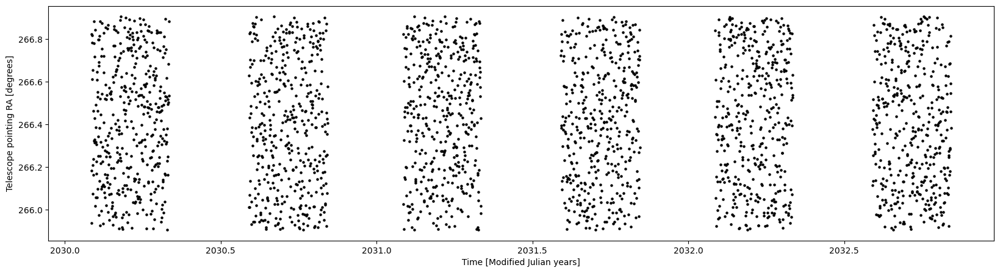

In [26]:
plt.figure(figsize=(20,5))
plt.scatter(att[:,1],np.rad2deg(att[:,2]),s=5,color="k")
plt.xlabel("Time [Modified Julian years]")
plt.ylabel("Telescope pointing RA [degrees]");

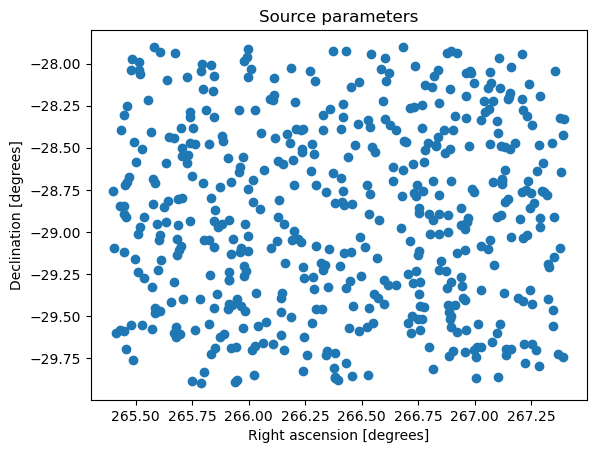

In [27]:
plt.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]))
plt.title("Source parameters")
plt.xlabel("Right ascension [degrees]")
plt.ylabel("Declination [degrees]");

### Generate first guess

In [28]:
src_guess_error = 10/_radiants_to_mas #based on Gaia positional precision
att_guess_error = 1000/_radiants_to_mas

src_guess_errors = np.random.uniform(-src_guess_error, src_guess_error, size=src[:, 1:].shape)
shat = src + 0
shat[:,1:] = src[:,1:] + src_guess_errors

att_guess_errors = np.random.uniform(-att_guess_error, att_guess_error, size=att[:, 1:].shape)
ahat = att + 0
ahat[:,1:] = att[:,1:] + att_guess_errors

### Generate model

In [29]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))

### Generate mock observations

#### small test

In [30]:
#define the basic functions that generate predictions and map them
_iterate_att = jax.vmap(model, (None, 0, None,0,0), 0) #iterate over the exposures
_iterate_full = jax.vmap(_iterate_att, (0, None,None,None,None), 0) #iterate over the sources and, for each, over the exposures
generate_predictions = lambda s, a,c, t,e: jnp.hstack(jnp.vstack(_iterate_full(s,a,c,t,e))) #wrapper

In [31]:
_iterate_att(src[0],att[:,2:],None,att[:,1],ephis).shape

(2495, 2)

In [32]:
_iterate_full(src[:,1:],att[:,2:],None,att[:,1],ephis).shape

(500, 2495, 2)

In [33]:
generate_predictions(src[:,1:],att[:,2:],None,att[:,1],ephis).shape

(2495000,)

#### actual run 

In [34]:
sig_obs = 100/_radiants_to_mas
obs = generate_mock_obs_simple_wephemeris(src,att,None,ephis,model,sig_obs)

In [35]:
obs.shape

(2495000, 4)

## Block iteration

#### Trying convergence of attitude

##### One exposure

In [36]:
ahat[0][2:]

array([ 4.64577602, -0.50309515,  1.02212298,  0.95363375])

In [37]:
update_attitude_inner(shat,ahat[0],None,ephis[0],obs,model)

Array([ 4.64577296, -0.50309349,  1.02211976,  0.95363768], dtype=float64)

In [38]:
att[0][2:]

array([ 4.64577296, -0.50309352,  1.02212038,  0.95363471])

##### All exposures

In [94]:
ahat2 = update_attitude(shat,ahat,None,ephis,obs,model)

In [98]:
scipy.stats.describe((ahat[:,2:]-att[:,2:])*_radiants_to_mas)

DescribeResult(nobs=2495, minmax=(array([-999.31012524, -996.55443707, -999.02138242, -999.03615214]), array([999.47886412, 999.93988042, 998.90378065, 999.43940046])), mean=array([ 7.1875907 , 20.44446024,  0.78100788, -2.05338682]), variance=array([336273.87742455, 323385.82015362, 329359.40810229, 328218.2936529 ]), skewness=array([-0.01168265, -0.02355145, -0.00196663,  0.011178  ]), kurtosis=array([-1.20518668, -1.16900097, -1.22133988, -1.16107335]))

In [97]:
scipy.stats.describe((ahat2-att[:,2:])*_radiants_to_mas)

DescribeResult(nobs=2495, minmax=(array([  -17.46318511,   -22.50781575, -1503.64345336, -1047.51995598]), array([  22.0641029 ,   16.39158036, 1090.12093793, 1229.78990817])), mean=array([ -0.19523818,  -0.19304075, -21.39404024,   1.53652854]), variance=array([3.22035377e+01, 2.55731693e+01, 1.13564414e+05, 1.10687350e+05]), skewness=array([ 0.02353729, -0.00225772, -0.04971486,  0.03794833]), kurtosis=array([-0.01121222,  0.19355578,  0.12615164, -0.03688227]))

#### Trying convergence of source

##### One source

In [99]:
shat[0][1:]

array([ 4.65438162, -0.51717881])

In [101]:
update_source_inner(shat[0],ahat,None,ephis,obs,None,None,None,model)

Array([ 4.65438163, -0.51717869], dtype=float64)

In [103]:
update_source_inner(shat[0],ahat2,None,ephis,obs,None,None,None,model)

array([ 4.65438162, -0.51717881])

In [102]:
src[0][1:]

array([ 4.6543816 , -0.51717879])

##### All sources

In [105]:
shat2 = update_source(shat,ahat,None,ephis,obs,None,None,None,model)

In [106]:
scipy.stats.describe((shat[:,1:]-src[:,1:])*_radiants_to_mas)

DescribeResult(nobs=500, minmax=(array([-9.94157299, -9.98607197]), array([9.94737969, 9.98860506])), mean=array([-0.1035534 , -0.06165453]), variance=array([33.9537059 , 32.61357581]), skewness=array([ 0.0379016 , -0.03239952]), kurtosis=array([-1.24463213, -1.17134304]))

In [107]:
scipy.stats.describe((shat2-src[:,1:])*_radiants_to_mas)

DescribeResult(nobs=500, minmax=(array([-0.61811022, 13.80517336]), array([12.45337418, 27.68021717])), mean=array([ 6.34244577, 20.2925453 ]), variance=array([5.09119461, 4.66676594]), skewness=array([-0.11184228,  0.05584131]), kurtosis=array([-0.04895791,  0.02165354]))

#### Full

In [108]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model,2,3,2)

CPU times: user 3min 54s, sys: 1min 20s, total: 5min 15s
Wall time: 2min 32s


In [110]:
scipy.stats.describe((att_opt[:,2:]-att[:,2:])*_radiants_to_mas)

DescribeResult(nobs=2495, minmax=(array([  -17.46413188,   -22.51064391, -1503.65262407, -1047.51953613]), array([  22.06424506,   16.3933149 , 1090.12327762, 1229.78336958])), mean=array([ -0.19527441,  -0.19332941, -21.39405756,   1.5351707 ]), variance=array([3.22045750e+01, 2.55743289e+01, 1.13564349e+05, 1.10687351e+05]), skewness=array([ 0.02360575, -0.00218274, -0.04971853,  0.03794928]), kurtosis=array([-0.01106871,  0.19356396,  0.12615476, -0.03688225]))

In [109]:
scipy.stats.describe((src_opt[:,1:]-src[:,1:])*_radiants_to_mas)

DescribeResult(nobs=500, minmax=(array([-6.91313987, -6.36820525]), array([5.87783445, 7.76923019])), mean=array([-0.10733917, -0.06096363]), variance=array([5.09273182, 4.5909998 ]), skewness=array([-0.11092235,  0.07694795]), kurtosis=array([-0.11335293,  0.04623749]))

In [112]:
np.std((att_opt[:,2:]-att[:,2:])*_radiants_to_mas,axis=0)

Array([  5.67377012,   5.05609322, 336.92555943, 332.63040679], dtype=float64)

In [113]:
np.std((src_opt[:,1:]-src[:,1:])*_radiants_to_mas,axis=0)

Array([2.25445034, 2.14051811], dtype=float64)

## Test 3.1: what if we used the wrong model?

In [66]:
#PREAMBLE
import jasmine_frame as jf
t0 = Time('2030-02-01', scale='tcb') + np.linspace(0,3,10000) * units.year
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T
ephemeris= jnp.column_stack((pos,vel))

#basic values
pkey = jax.random.PRNGKey(42)
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1

#check times of observation of this field
fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask = jasmine.observable(fov_centre)

#generate true values of the mock sources
source_id = jnp.arange(500)
alpha0 = np.deg2rad(alpha00+np.random.uniform(-1.0, 1.0, size=source_id.shape))
delta0 = np.deg2rad(delta00+np.random.uniform(-1.0, 1.0, size=source_id.shape))

#generate true values of the attitude
ep = t0.decimalyear[observational_mask]
exposure_id = jnp.arange(len(ep))
pt_ra = np.deg2rad(pt_ra0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_dec = np.deg2rad(pt_dec0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_rot = np.deg2rad(pt_rot0 + np.random.uniform(-0.1,0.1, size=exposure_id.shape))
F = F0*np.random.uniform(0.9,1.1, size=exposure_id.shape)

#select corresponding ephemeris
ephis = ephemeris[observational_mask]

src = np.stack([source_id, alpha0, delta0]).T
att = np.stack([exposure_id, ep, pt_ra,pt_dec,pt_rot,F]).T

#first guess
src_guess_error = 10/_radiants_to_mas #based on Gaia positional precision
att_guess_error = 1000/_radiants_to_mas

src_guess_errors = np.random.uniform(-src_guess_error, src_guess_error, size=src[:, 1:].shape)
shat = src + 0
shat[:,1:] = src[:,1:] + src_guess_errors

att_guess_errors = np.random.uniform(-att_guess_error, att_guess_error, size=att[:, 1:].shape)
ahat = att + 0
ahat[:,1:] = att[:,1:] + att_guess_errors

In [67]:
print(ephemeris.shape,ephis.shape)

(10000, 6) (2495, 6)


In [7]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))

In [8]:
sig_obs = 100/_radiants_to_mas
obs = generate_mock_obs_simple_wephemeris(src,att,None,ephis,model,sig_obs)

In [90]:
i = 0
k = 1000
ra1,dec1 = _icrs2comrs(src[i][1],src[i][2],None,_jasmine_ephemeris = ephis[k],_deltavx=-ephis[k][-3],_deltavy=-ephis[k][-3],_deltavz=-ephis[k][-3])
print((ra1-to_pi(src[i][1]))*_radiants_to_mas,(dec1-to_pi(src[i][2]))*_radiants_to_mas)
print(np.sqrt(((ra1-to_pi(src[i][1]))*_radiants_to_mas)**2 + ((dec1-to_pi(src[i][2]))*_radiants_to_mas)**2))

1085.3757367103444 5362.38008749377
5471.120606657215


In [103]:
max_dev = -1.0
min_dev = 999999
for i in range(len(src))[::10]:
    for k in range(len(ephis))[::10]:
        ra1,dec1 = _icrs2comrs(src[i][1],src[i][2],None,_jasmine_ephemeris = ephis[k],_deltavx=-ephis[k][3],_deltavy=-ephis[k][4],_deltavz=-ephis[k][5])
        dev = np.sqrt(((ra1-to_pi(src[i][1]))*_radiants_to_mas)**2 + ((dec1-to_pi(src[i][2]))*_radiants_to_mas)**2).item()
        max_dev = max(max_dev,dev)
        min_dev = min(min_dev,dev)

In [104]:
print(min_dev,max_dev)

1.8733325532050733 11.64139812787589


### Test 3.1.1: ignoring light bending due to the Sun

In [9]:
model_wrong = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi,_Msun=0),a[0],a[1],a[2]),a[3])))

In [10]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model_wrong,1,1,1)

CPU times: user 44.3 s, sys: 14.1 s, total: 58.5 s
Wall time: 27.4 s


#### Plotting residuals

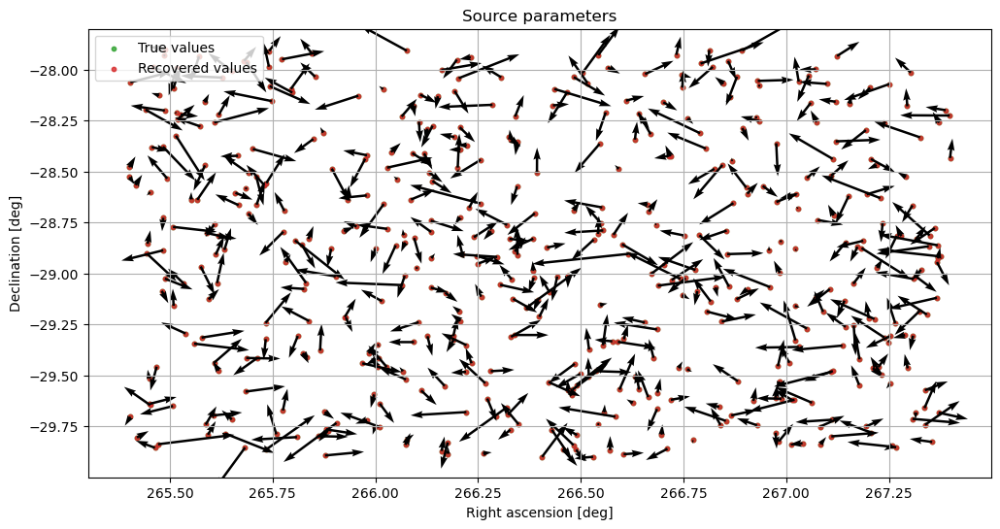

In [11]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),color="k",scale_units="xy",scale=1e-5);

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

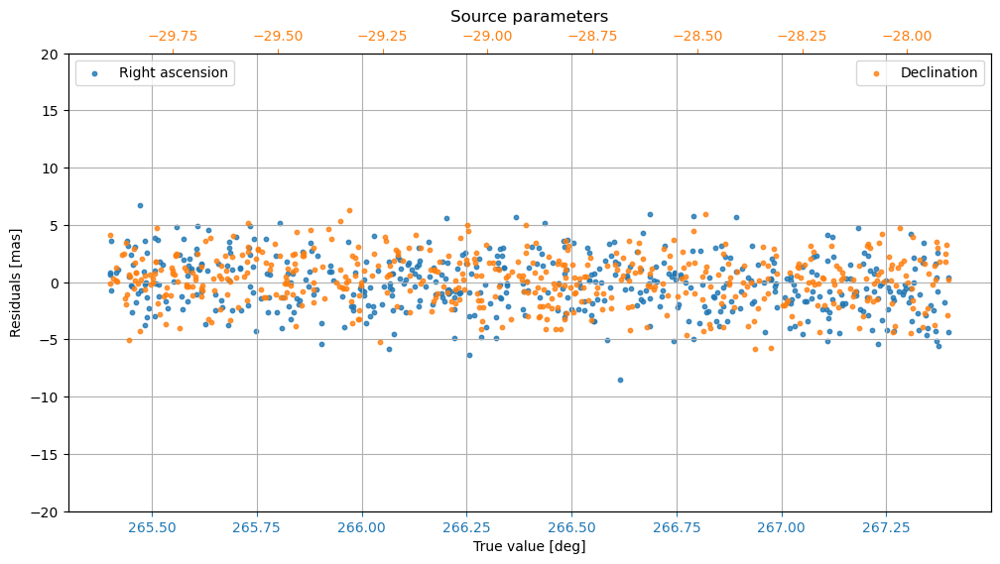

In [12]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-20,20);
ax.grid();

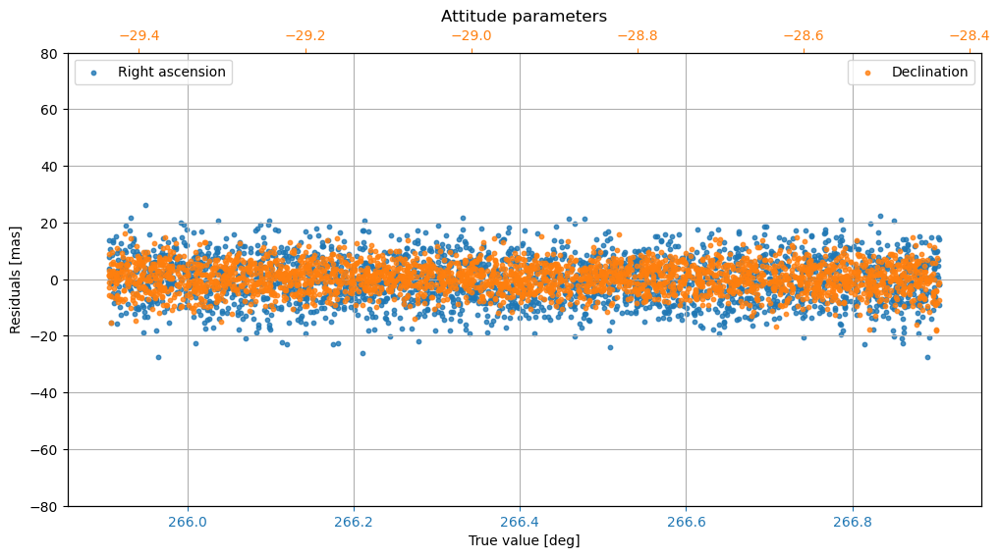

In [13]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
ax.set_ylim(-80,80);
ax.grid();

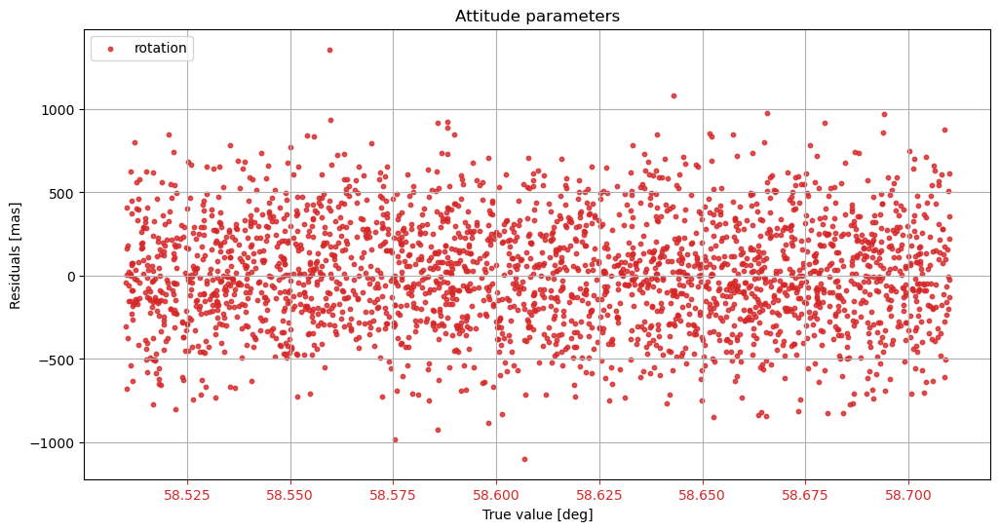

In [14]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

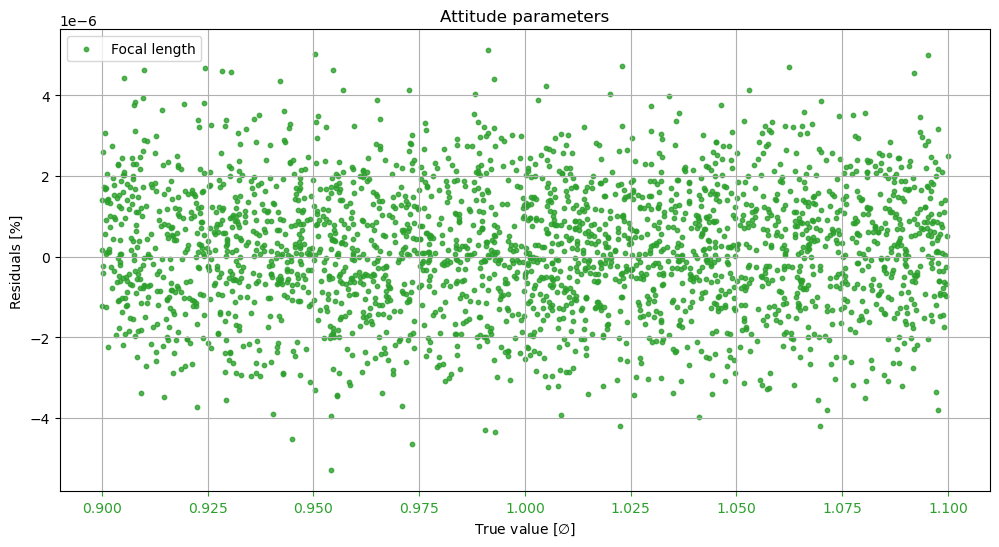

In [15]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

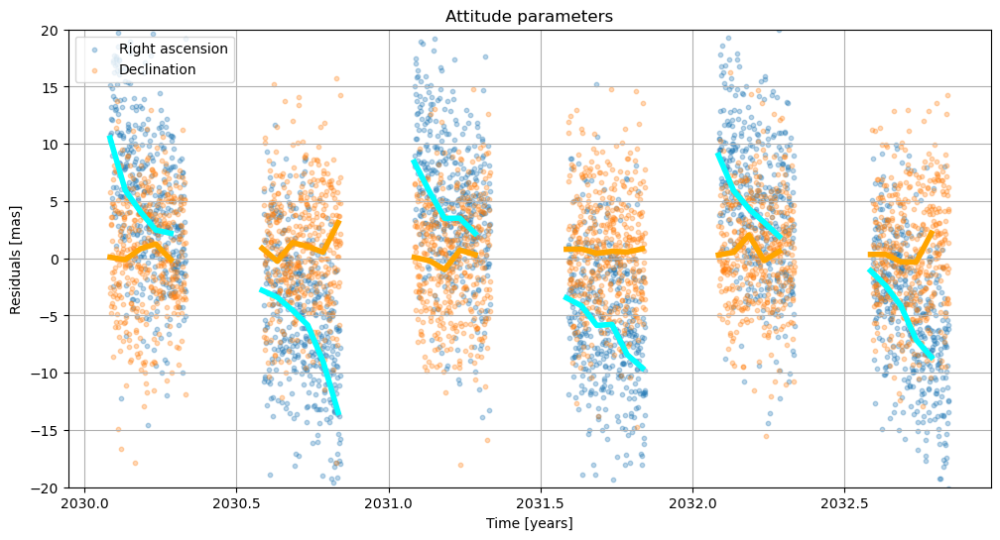

In [16]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

### Test 3.1.2: ignoring stellar aberration and light bending due to the Sun

In [17]:
model_wrong = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(s[0],s[1],a[0],a[1],a[2]),a[3])))

In [18]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model_wrong,1,1,1)

CPU times: user 40.2 s, sys: 15.3 s, total: 55.5 s
Wall time: 25.4 s


#### Plotting residuals

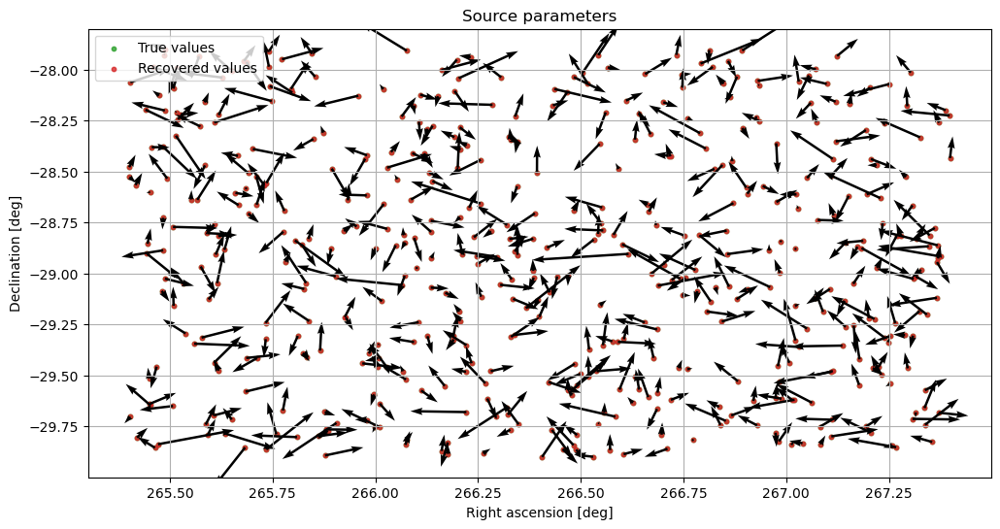

In [19]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),color="k",scale_units="xy",scale=1e-5);

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

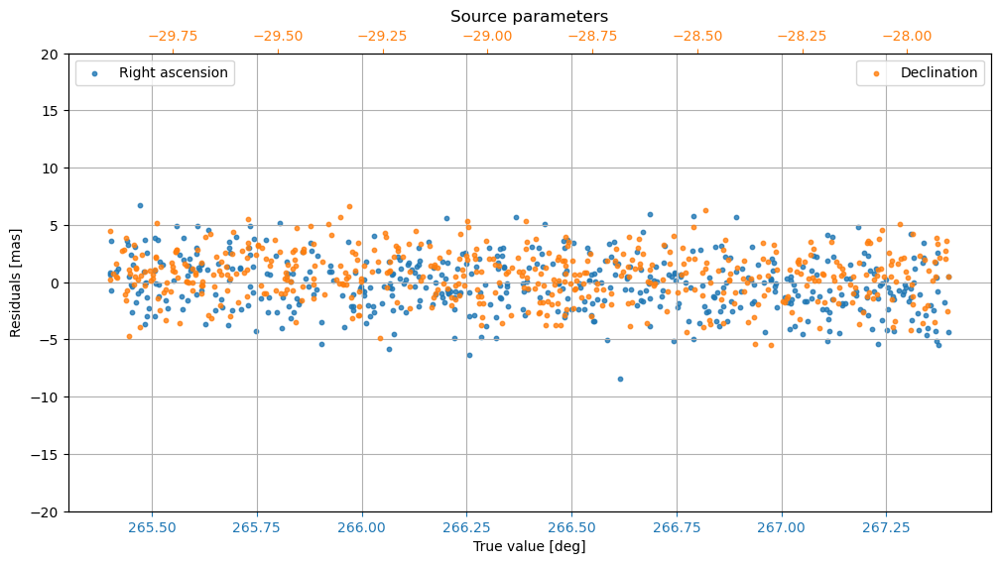

In [20]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-20,20);
ax.grid();

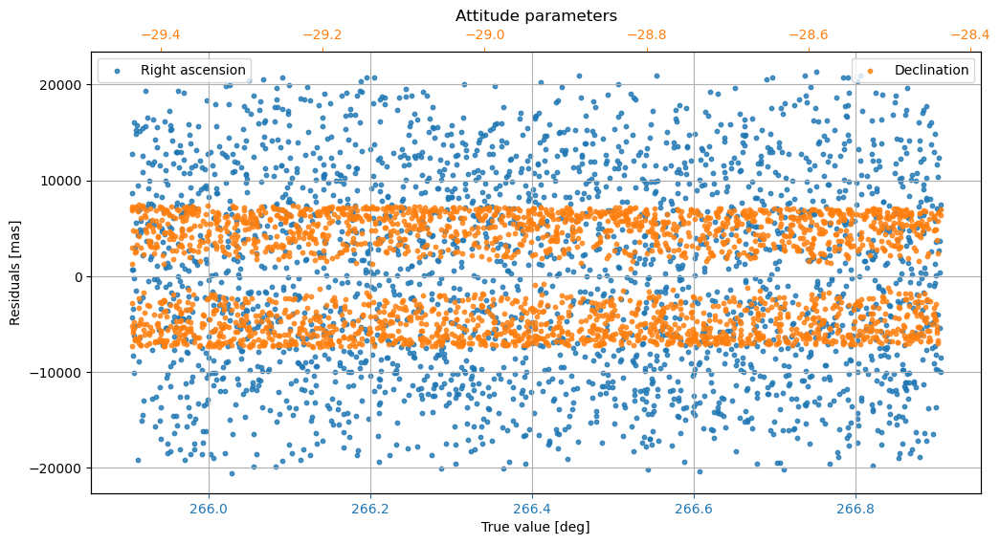

In [21]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

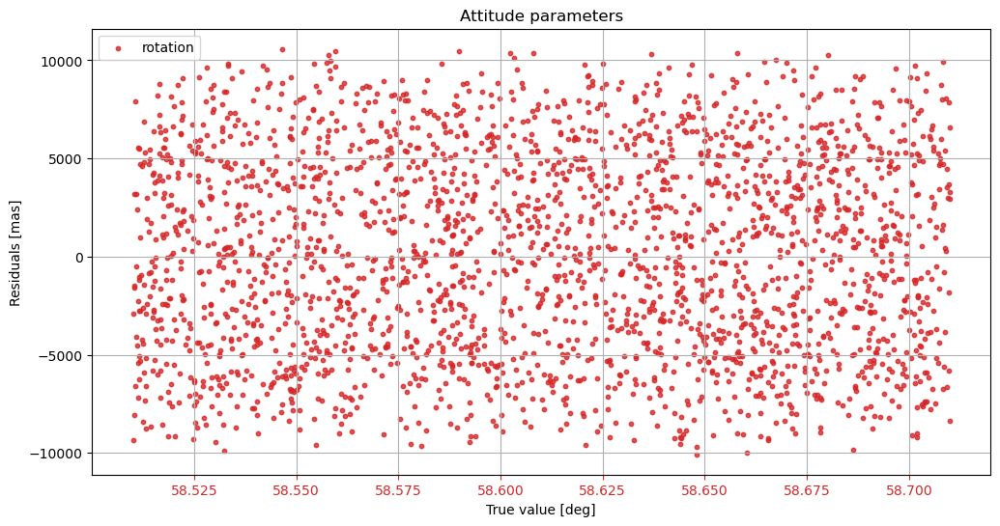

In [22]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

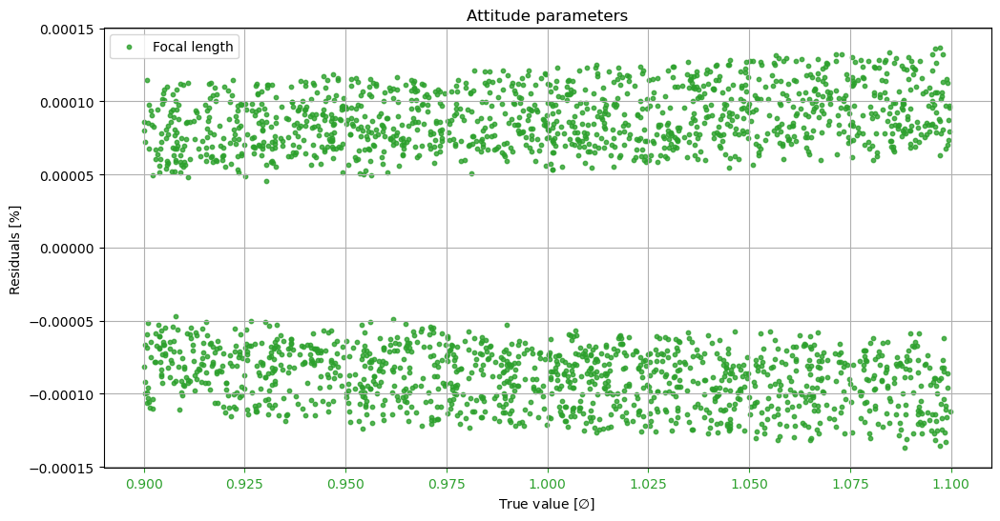

In [23]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

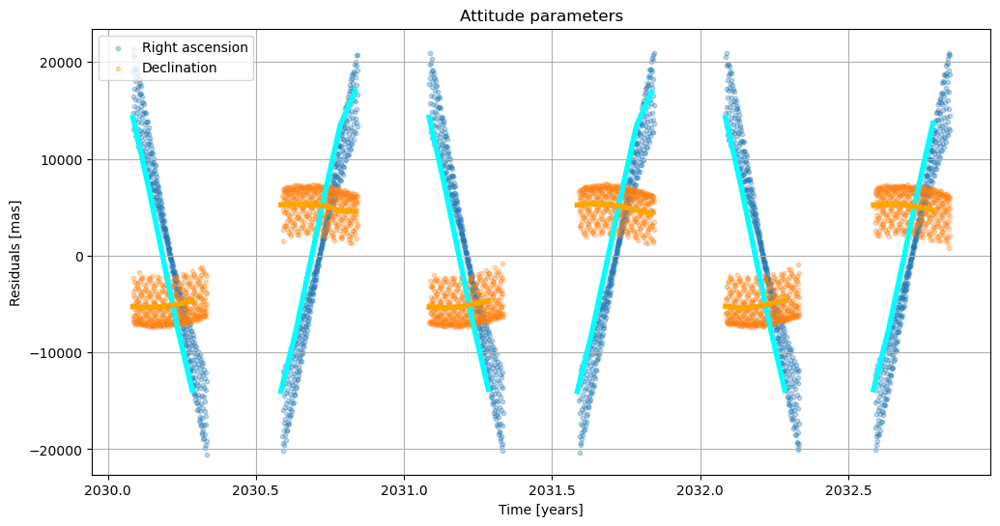

In [24]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

## Test 3.2: what if we used the right model but the wrong ephemeris?

### Test 3.2.1: random velocity disturbances of 100 m/s

In [25]:
vel_dist = 100 #m/s

In [26]:
#PREAMBLE
import jasmine_frame as jf
t0 = Time('2030-02-01', scale='tcb') + np.linspace(0,3,10000) * units.year
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T
ephemeris = jnp.column_stack((pos,vel))
vel_true = vel + np.random.normal(0,scale=vel_dist,size=vel.shape)
ephemeris_true = jnp.column_stack((pos,vel_true))

#basic values
pkey = jax.random.PRNGKey(42)
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1

#check times of observation of this field
fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask = jasmine.observable(fov_centre)

#generate true values of the mock sources
source_id = jnp.arange(500)
alpha0 = np.deg2rad(alpha00+np.random.uniform(-1.0, 1.0, size=source_id.shape))
delta0 = np.deg2rad(delta00+np.random.uniform(-1.0, 1.0, size=source_id.shape))

#generate true values of the attitude
ep = t0.decimalyear[observational_mask]
exposure_id = jnp.arange(len(ep))
pt_ra = np.deg2rad(pt_ra0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_dec = np.deg2rad(pt_dec0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_rot = np.deg2rad(pt_rot0 + np.random.uniform(-0.1,0.1, size=exposure_id.shape))
F = F0*np.random.uniform(0.9,1.1, size=exposure_id.shape)

#select corresponding ephemeris
ephis_true = ephemeris_true[observational_mask]
ephis = ephemeris[observational_mask]

src = np.stack([source_id, alpha0, delta0]).T
att = np.stack([exposure_id, ep, pt_ra,pt_dec,pt_rot,F]).T

#first guess
src_guess_error = 10/_radiants_to_mas #based on Gaia positional precision
att_guess_error = 1000/_radiants_to_mas

src_guess_errors = np.random.uniform(-src_guess_error, src_guess_error, size=src[:, 1:].shape)
shat = src + 0
shat[:,1:] = src[:,1:] + src_guess_errors

att_guess_errors = np.random.uniform(-att_guess_error, att_guess_error, size=att[:, 1:].shape)
ahat = att + 0
ahat[:,1:] = att[:,1:] + att_guess_errors

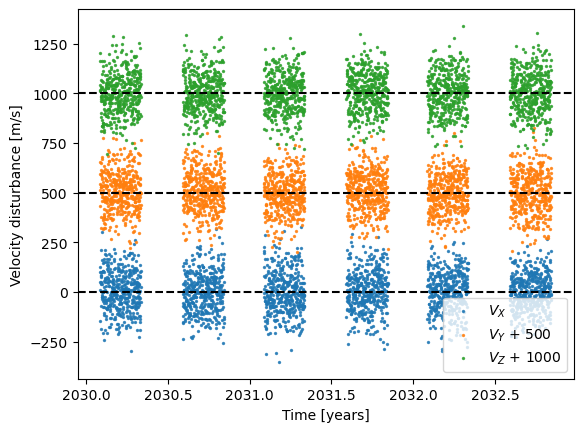

In [27]:
plt.scatter(att[:,1],ephis_true[:,3]-ephis[:,3],label=r"$V_X$",s=2,alpha=0.8)
plt.axhline(0,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,4]-ephis[:,4] + 500,label=r"$V_Y$ + 500",s=2,alpha=0.8)
plt.axhline(500,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,5]-ephis[:,5] + 2*500,label=r"$V_Z$ + 1000",s=2,alpha=0.8)
plt.axhline(2*500,color="k",ls="--")
plt.xlabel("Time [years]")
plt.ylabel("Velocity disturbance [m/s]")
plt.legend();

In [28]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))

In [29]:
sig_obs = 100/_radiants_to_mas
obs = generate_mock_obs_simple_wephemeris(src,att,None,ephis_true,model,sig_obs)

In [30]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model,1,1,1)

CPU times: user 43.7 s, sys: 15.1 s, total: 58.9 s
Wall time: 27 s


In [31]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

2.002003005008766 2.3787025398382227 1.9252459511212907


#### Plotting residuals

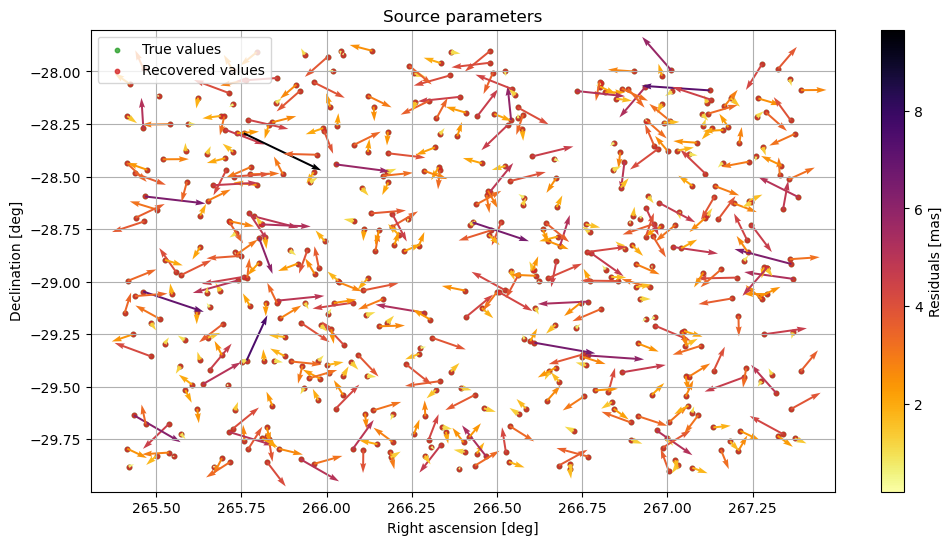

In [50]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=1e-5);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

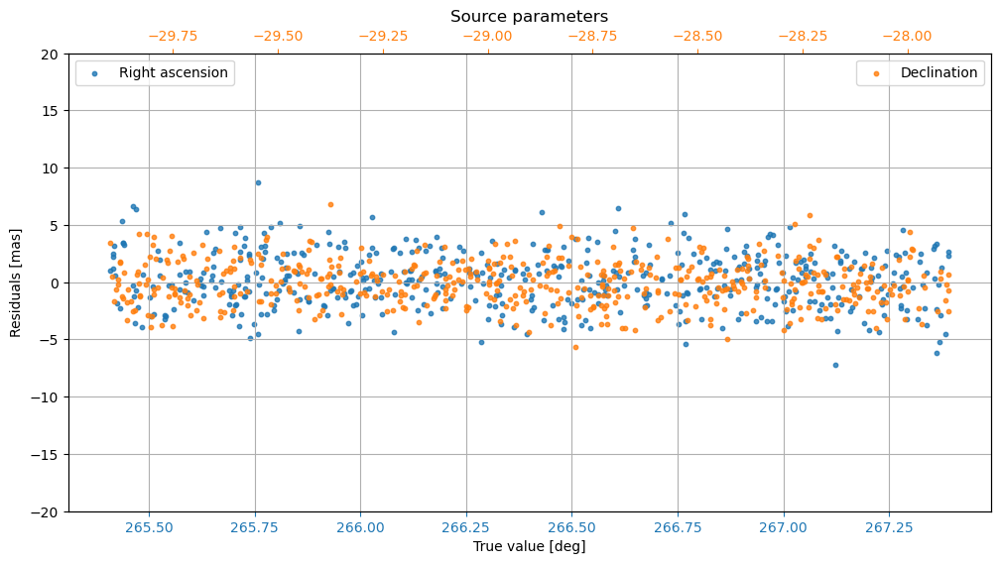

In [51]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-20,20);
ax.grid();

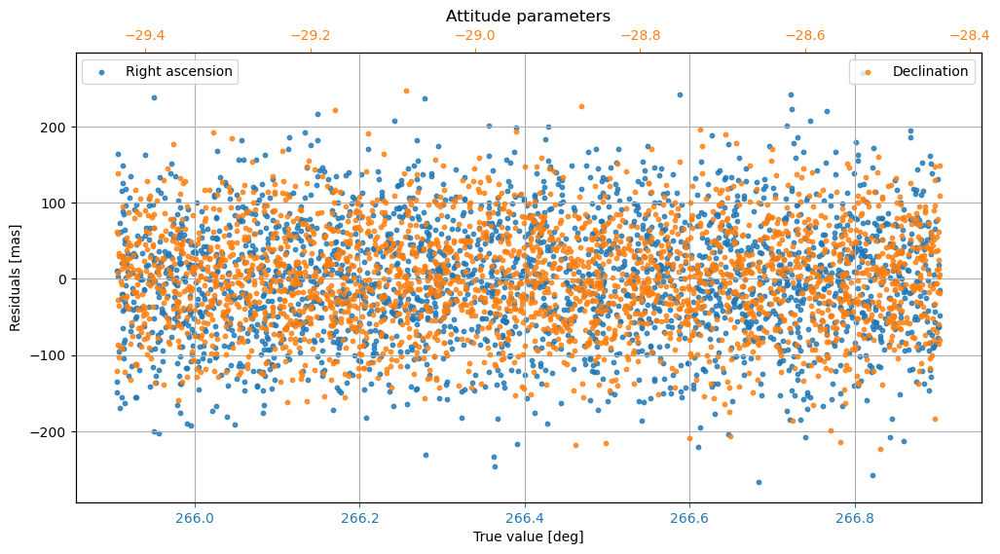

In [52]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

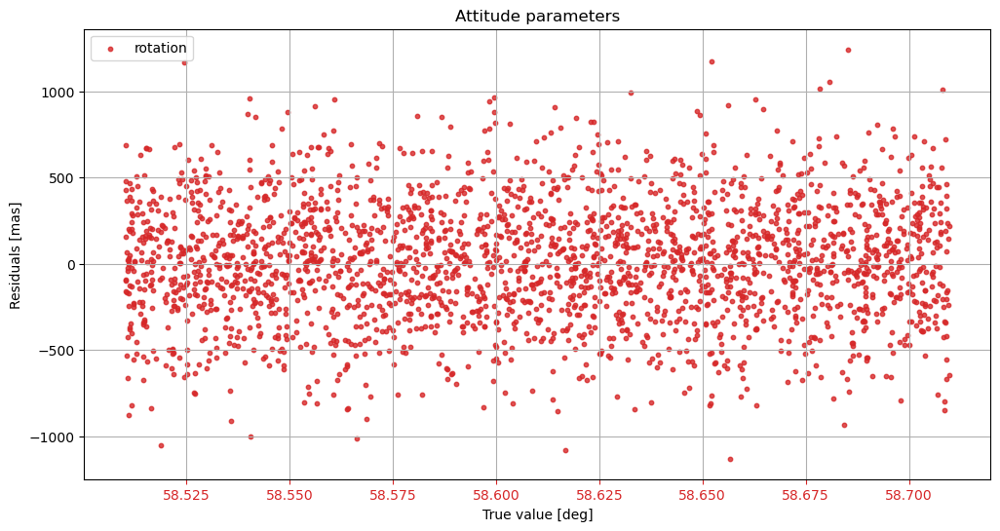

In [53]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

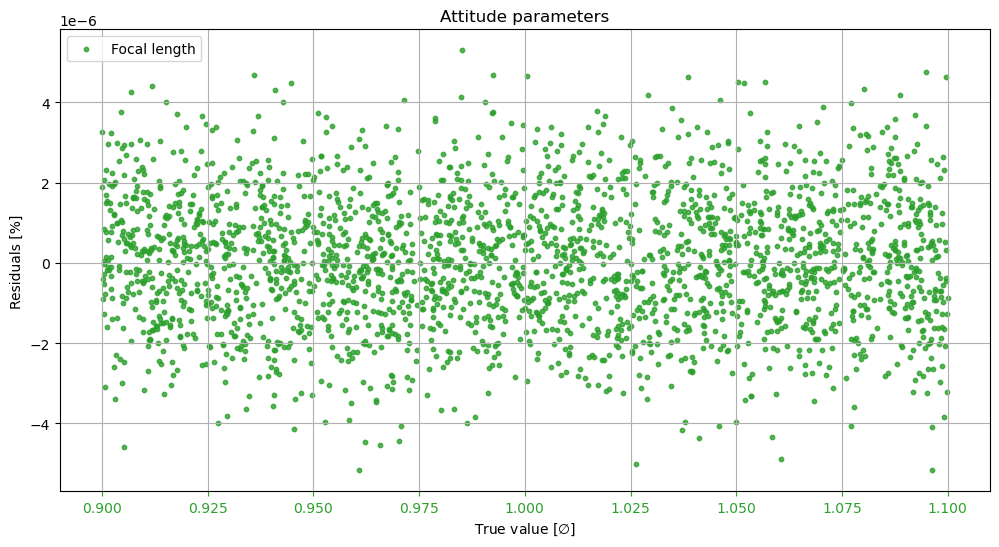

In [54]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

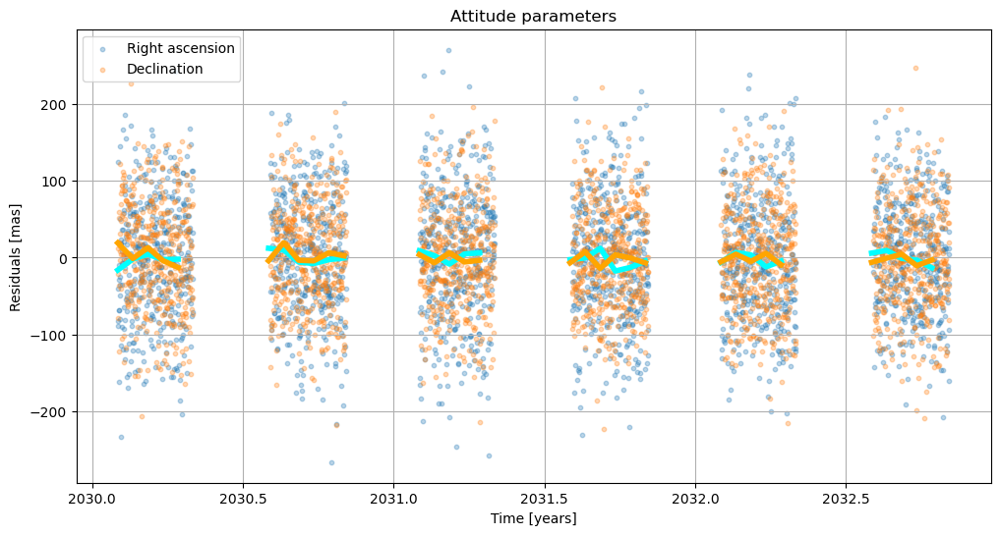

In [55]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

### Test 3.2.2: random velocity disturbances of 1000 m/s

In [56]:
vel_dist = 1000 #m/s

In [57]:
#PREAMBLE
import jasmine_frame as jf
t0 = Time('2030-02-01', scale='tcb') + np.linspace(0,3,10000) * units.year
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T
ephemeris = jnp.column_stack((pos,vel))
vel_true = vel + np.random.normal(0,scale=vel_dist,size=vel.shape)
ephemeris_true = jnp.column_stack((pos,vel_true))

#basic values
pkey = jax.random.PRNGKey(42)
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1

#check times of observation of this field
fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask = jasmine.observable(fov_centre)

#generate true values of the mock sources
source_id = jnp.arange(500)
alpha0 = np.deg2rad(alpha00+np.random.uniform(-1.0, 1.0, size=source_id.shape))
delta0 = np.deg2rad(delta00+np.random.uniform(-1.0, 1.0, size=source_id.shape))

#generate true values of the attitude
ep = t0.decimalyear[observational_mask]
exposure_id = jnp.arange(len(ep))
pt_ra = np.deg2rad(pt_ra0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_dec = np.deg2rad(pt_dec0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_rot = np.deg2rad(pt_rot0 + np.random.uniform(-0.1,0.1, size=exposure_id.shape))
F = F0*np.random.uniform(0.9,1.1, size=exposure_id.shape)

#select corresponding ephemeris
ephis_true = ephemeris_true[observational_mask]
ephis = ephemeris[observational_mask]

src = np.stack([source_id, alpha0, delta0]).T
att = np.stack([exposure_id, ep, pt_ra,pt_dec,pt_rot,F]).T

#first guess
src_guess_error = 10/_radiants_to_mas #based on Gaia positional precision
att_guess_error = 1000/_radiants_to_mas

src_guess_errors = np.random.uniform(-src_guess_error, src_guess_error, size=src[:, 1:].shape)
shat = src + 0
shat[:,1:] = src[:,1:] + src_guess_errors

att_guess_errors = np.random.uniform(-att_guess_error, att_guess_error, size=att[:, 1:].shape)
ahat = att + 0
ahat[:,1:] = att[:,1:] + att_guess_errors

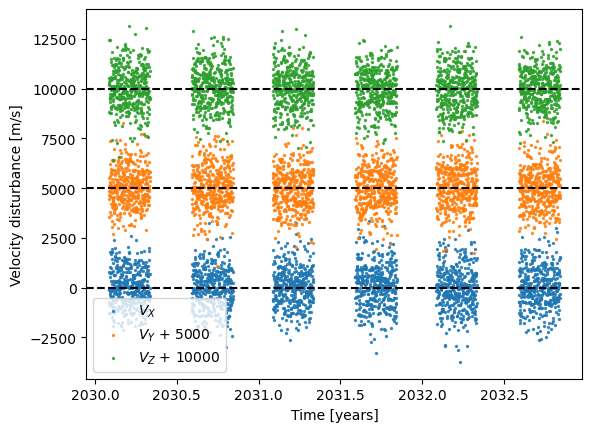

In [58]:
plt.scatter(att[:,1],ephis_true[:,3]-ephis[:,3],label=r"$V_X$",s=2,alpha=0.8)
plt.axhline(0,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,4]-ephis[:,4] + 5000,label=r"$V_Y$ + 5000",s=2,alpha=0.8)
plt.axhline(5000,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,5]-ephis[:,5] + 2*5000,label=r"$V_Z$ + 10000",s=2,alpha=0.8)
plt.axhline(2*5000,color="k",ls="--")
plt.xlabel("Time [years]")
plt.ylabel("Velocity disturbance [m/s]")
plt.legend();

In [59]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))

In [60]:
sig_obs = 100/_radiants_to_mas
obs = generate_mock_obs_simple_wephemeris(src,att,None,ephis_true,model,sig_obs)

In [61]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model,1,1,1)

CPU times: user 44.6 s, sys: 14.6 s, total: 59.2 s
Wall time: 26.5 s


#### Plotting residuals

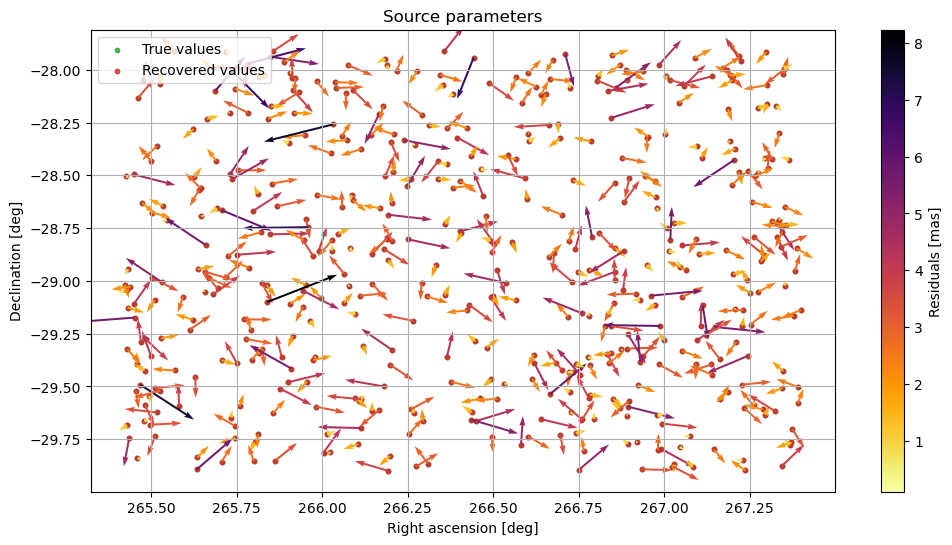

In [64]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=1e-5);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

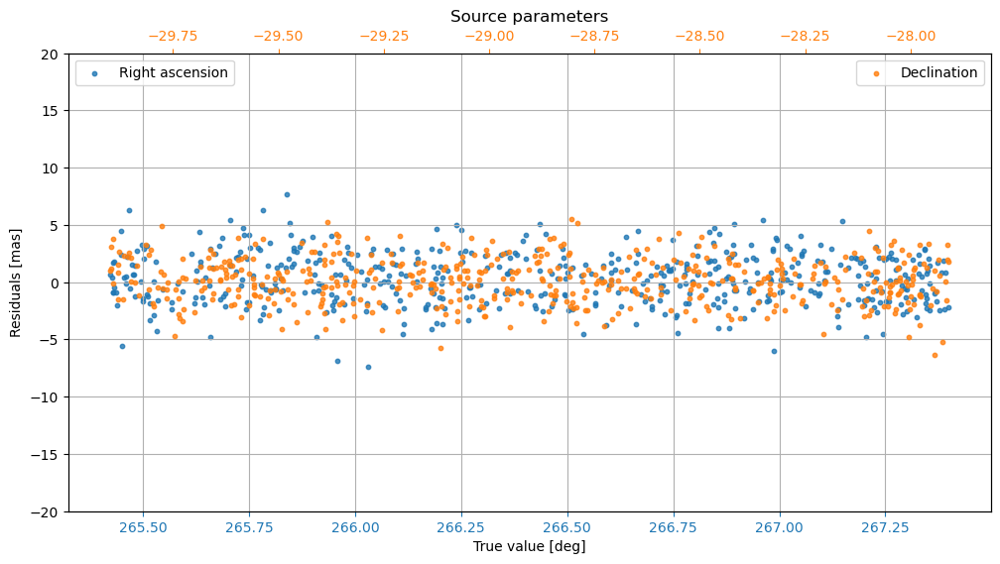

In [65]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-20,20);
ax.grid();

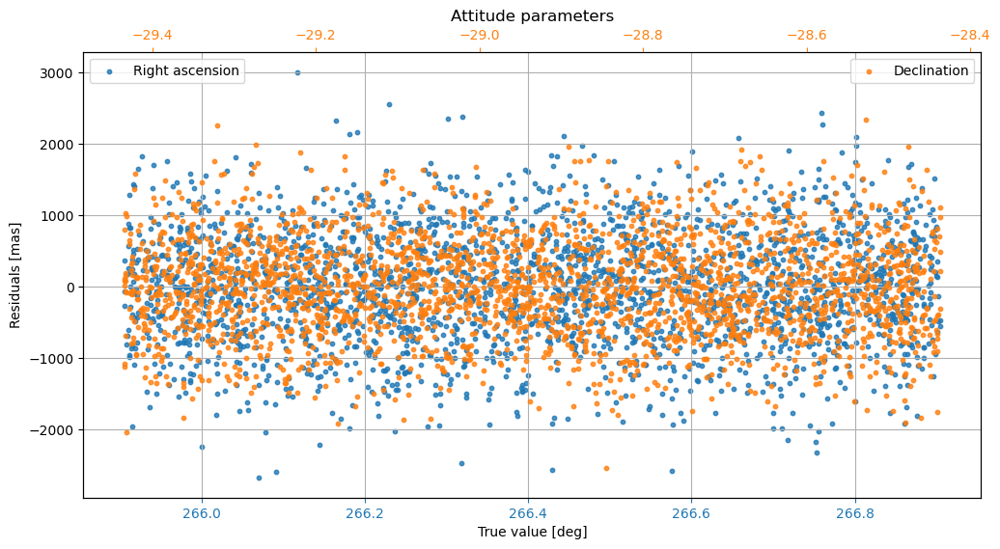

In [66]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

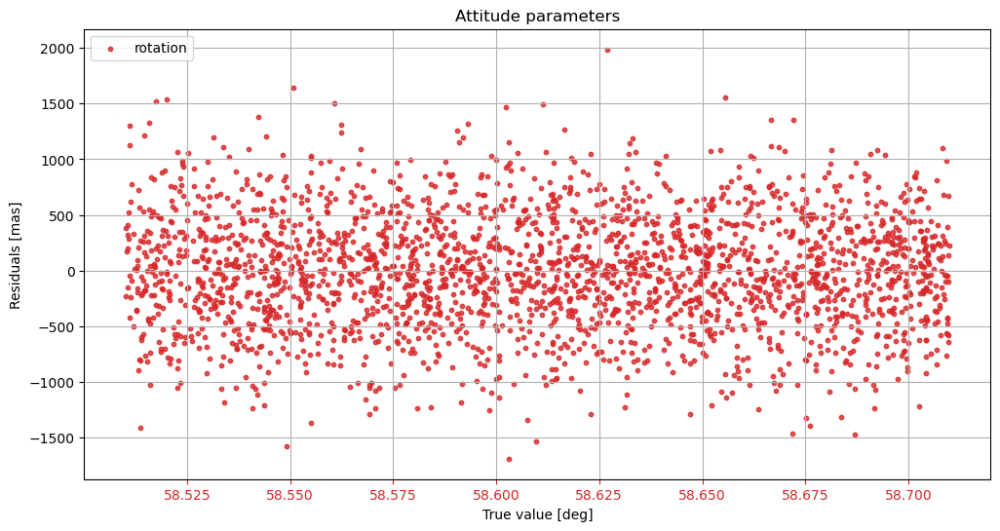

In [67]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

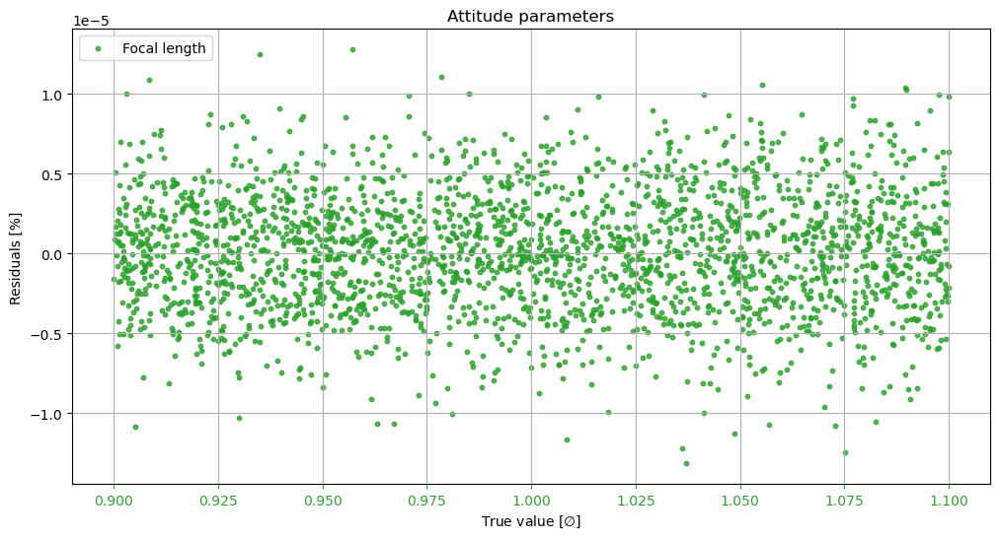

In [68]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

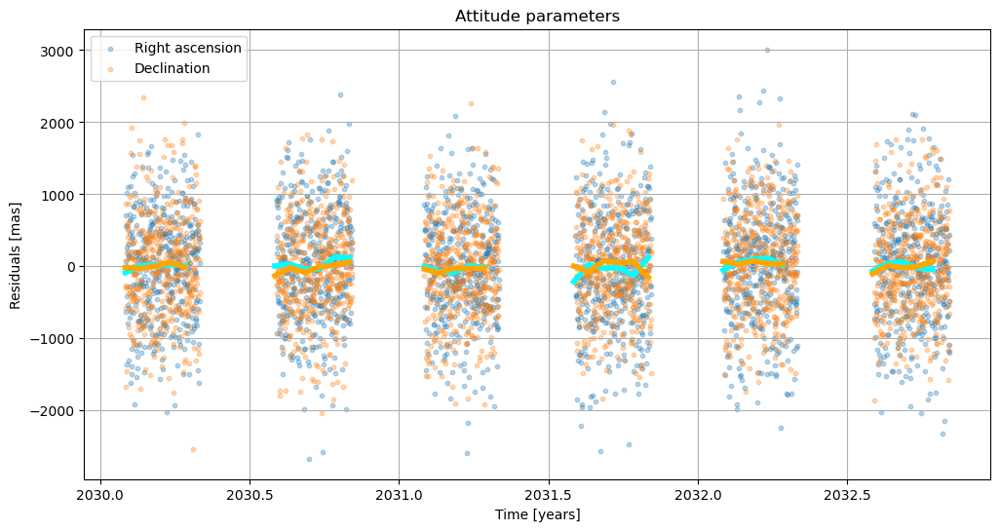

In [69]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

### Test 3.2.3: same as 3.2.1 but x10 more observations per source

In [70]:
vel_dist = 100 #m/s

In [71]:
#PREAMBLE
import jasmine_frame as jf
t0 = Time('2030-02-01', scale='tcb') + np.linspace(0,3,100000) * units.year
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T
ephemeris = jnp.column_stack((pos,vel))
vel_true = vel + np.random.normal(0,scale=vel_dist,size=vel.shape)
ephemeris_true = jnp.column_stack((pos,vel_true))

#basic values
pkey = jax.random.PRNGKey(42)
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1

#check times of observation of this field
fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask = jasmine.observable(fov_centre)

#generate true values of the mock sources
source_id = jnp.arange(500)
alpha0 = np.deg2rad(alpha00+np.random.uniform(-1.0, 1.0, size=source_id.shape))
delta0 = np.deg2rad(delta00+np.random.uniform(-1.0, 1.0, size=source_id.shape))

#generate true values of the attitude
ep = t0.decimalyear[observational_mask]
exposure_id = jnp.arange(len(ep))
pt_ra = np.deg2rad(pt_ra0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_dec = np.deg2rad(pt_dec0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_rot = np.deg2rad(pt_rot0 + np.random.uniform(-0.1,0.1, size=exposure_id.shape))
F = F0*np.random.uniform(0.9,1.1, size=exposure_id.shape)

#select corresponding ephemeris
ephis_true = ephemeris_true[observational_mask]
ephis = ephemeris[observational_mask]

src = np.stack([source_id, alpha0, delta0]).T
att = np.stack([exposure_id, ep, pt_ra,pt_dec,pt_rot,F]).T

#first guess
src_guess_error = 10/_radiants_to_mas #based on Gaia positional precision
att_guess_error = 1000/_radiants_to_mas

src_guess_errors = np.random.uniform(-src_guess_error, src_guess_error, size=src[:, 1:].shape)
shat = src + 0
shat[:,1:] = src[:,1:] + src_guess_errors

att_guess_errors = np.random.uniform(-att_guess_error, att_guess_error, size=att[:, 1:].shape)
ahat = att + 0
ahat[:,1:] = att[:,1:] + att_guess_errors

In [72]:
len(ep)

24977

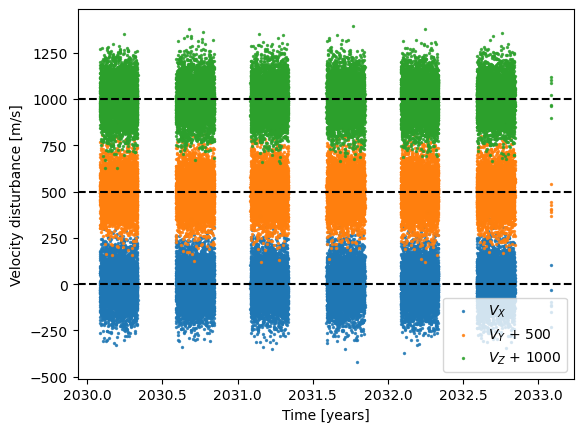

In [73]:
plt.scatter(att[:,1],ephis_true[:,3]-ephis[:,3],label=r"$V_X$",s=2,alpha=0.8)
plt.axhline(0,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,4]-ephis[:,4] + 500,label=r"$V_Y$ + 500",s=2,alpha=0.8)
plt.axhline(500,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,5]-ephis[:,5] + 2*500,label=r"$V_Z$ + 1000",s=2,alpha=0.8)
plt.axhline(2*500,color="k",ls="--")
plt.xlabel("Time [years]")
plt.ylabel("Velocity disturbance [m/s]")
plt.legend();

In [74]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))

In [75]:
sig_obs = 100/_radiants_to_mas
obs = generate_mock_obs_simple_wephemeris(src,att,None,ephis_true,model,sig_obs)

In [76]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model,1,1,1)

CPU times: user 30min 1s, sys: 44min 49s, total: 1h 14min 50s
Wall time: 21min 23s


10 times more observations took 50 times more time to compute

10 times more observations took 54 times more time to compute

In [77]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.6327466624738229 0.8127905350659074 0.6423021346559366


In [219]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.6327466624738229 0.7564213781809055 0.646755387335055


In [232]:
print("Goal for position precision (PSF errors of ~10mas and 60k observations): ",((10*units.mas)/np.sqrt(6e4)).to(units.microarcsecond))

Goal for position precision (PSF errors of ~10mas and 60k observations):  40.824829046386306 uarcsec


#### Plotting residuals

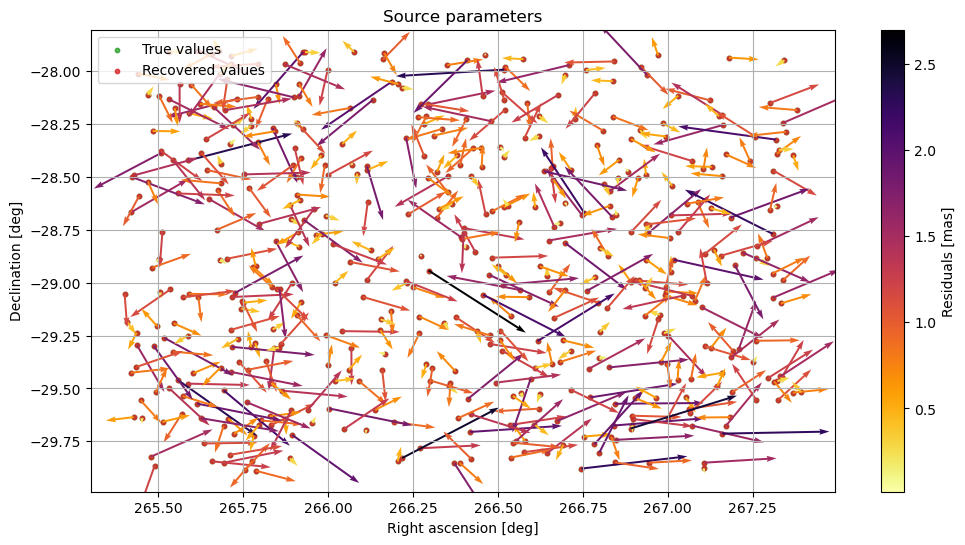

In [80]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=2e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

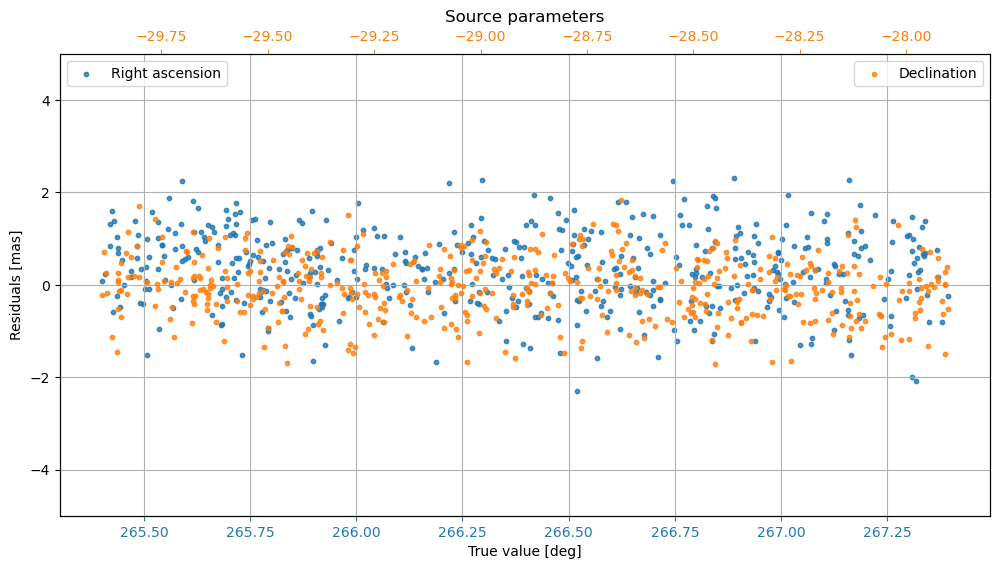

In [81]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-5,5);
ax.grid();

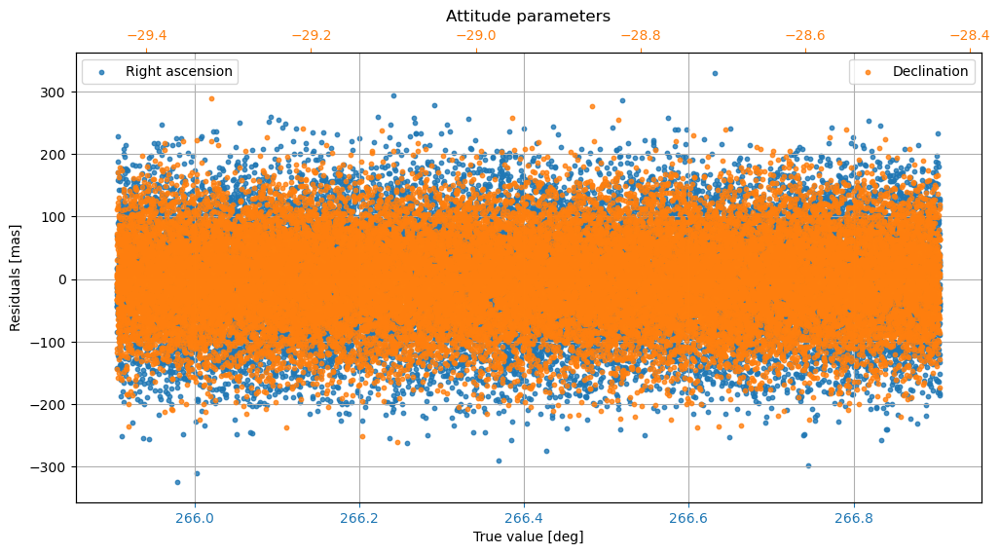

In [82]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

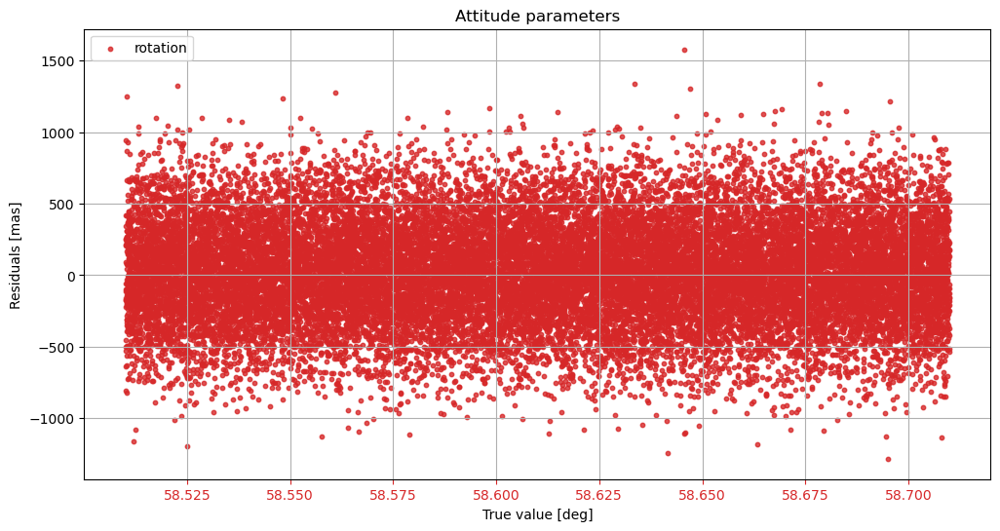

In [83]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

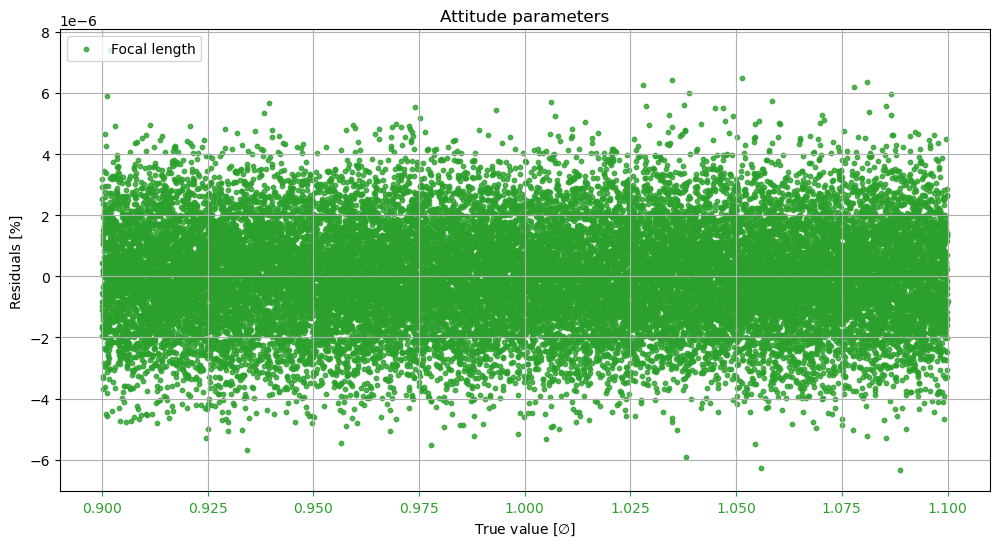

In [84]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

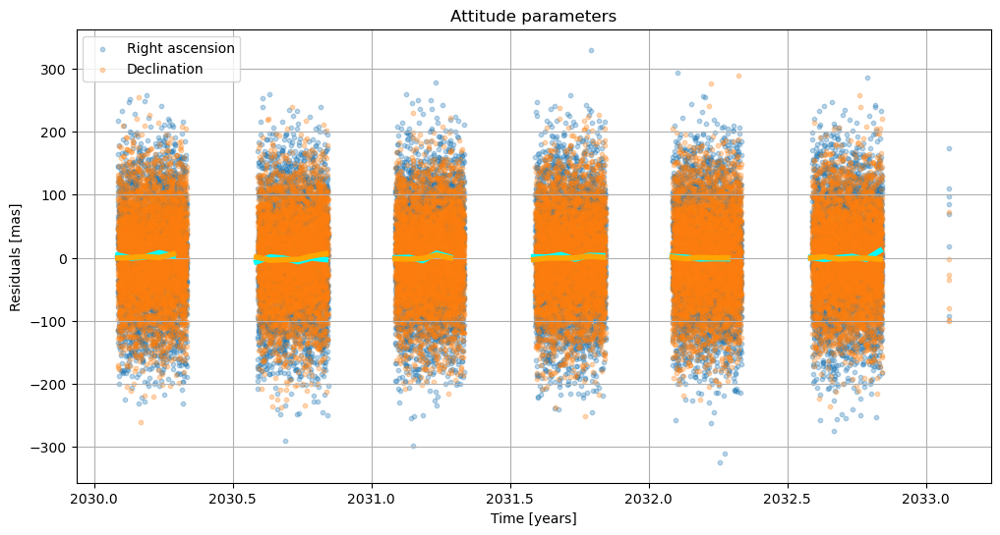

In [85]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

### Test 3.2.4: same as 3.2.1 but way smaller observational uncertainties per source 

In [105]:
vel_dist = 100 #m/s

In [106]:
#PREAMBLE
import jasmine_frame as jf
t0 = Time('2030-02-01', scale='tcb') + np.linspace(0,3,10000) * units.year
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T
ephemeris = jnp.column_stack((pos,vel))
vel_true = vel + np.random.normal(0,scale=vel_dist,size=vel.shape)
ephemeris_true = jnp.column_stack((pos,vel_true))

#basic values
pkey = jax.random.PRNGKey(42)
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1

#check times of observation of this field
fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask = jasmine.observable(fov_centre)

#generate true values of the mock sources
source_id = jnp.arange(500)
alpha0 = np.deg2rad(alpha00+np.random.uniform(-1.0, 1.0, size=source_id.shape))
delta0 = np.deg2rad(delta00+np.random.uniform(-1.0, 1.0, size=source_id.shape))

#generate true values of the attitude
ep = t0.decimalyear[observational_mask]
exposure_id = jnp.arange(len(ep))
pt_ra = np.deg2rad(pt_ra0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_dec = np.deg2rad(pt_dec0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_rot = np.deg2rad(pt_rot0 + np.random.uniform(-0.1,0.1, size=exposure_id.shape))
F = F0*np.random.uniform(0.9,1.1, size=exposure_id.shape)

#select corresponding ephemeris
ephis_true = ephemeris_true[observational_mask]
ephis = ephemeris[observational_mask]

src = np.stack([source_id, alpha0, delta0]).T
att = np.stack([exposure_id, ep, pt_ra,pt_dec,pt_rot,F]).T

#first guess
src_guess_error = 10/_radiants_to_mas #based on Gaia positional precision
att_guess_error = 1000/_radiants_to_mas

src_guess_errors = np.random.uniform(-src_guess_error, src_guess_error, size=src[:, 1:].shape)
shat = src + 0
shat[:,1:] = src[:,1:] + src_guess_errors

att_guess_errors = np.random.uniform(-att_guess_error, att_guess_error, size=att[:, 1:].shape)
ahat = att + 0
ahat[:,1:] = att[:,1:] + att_guess_errors

In [107]:
len(ep)

2495

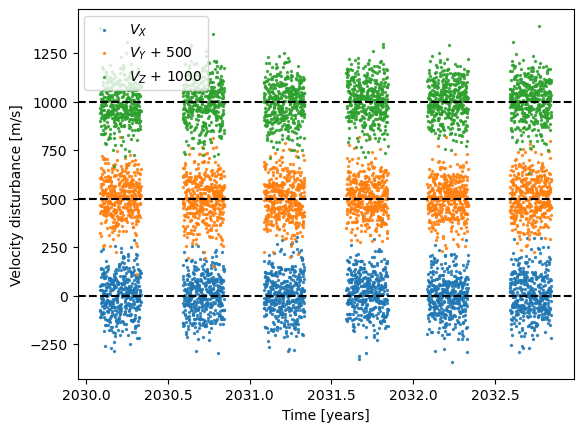

In [108]:
plt.scatter(att[:,1],ephis_true[:,3]-ephis[:,3],label=r"$V_X$",s=2,alpha=0.8)
plt.axhline(0,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,4]-ephis[:,4] + 500,label=r"$V_Y$ + 500",s=2,alpha=0.8)
plt.axhline(500,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,5]-ephis[:,5] + 2*500,label=r"$V_Z$ + 1000",s=2,alpha=0.8)
plt.axhline(2*500,color="k",ls="--")
plt.xlabel("Time [years]")
plt.ylabel("Velocity disturbance [m/s]")
plt.legend();

In [109]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))

In [110]:
sig_obs = 1/_radiants_to_mas
obs = generate_mock_obs_simple_wephemeris(src,att,None,ephis_true,model,sig_obs)

In [111]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)))

0.020020030050087657


In [112]:
print("Goal for position precision (PSF errors of ~10mas and 60k observations): ",((10*units.mas)/np.sqrt(6e4)).to(units.microarcsecond))

Goal for position precision (PSF errors of ~10mas and 60k observations):  40.824829046386306 uarcsec


In [113]:
sig_obs*_radiants_to_mas/np.sqrt(500)

np.float64(0.04472135954999579)

In [114]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model,1,1,1)

CPU times: user 46.6 s, sys: 16.9 s, total: 1min 3s
Wall time: 30.2 s


In [96]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.020020030050087657 0.43783675620131846 0.34109353521021146


In [104]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.020020030050087657 0.4590162259870547 0.448971851004185


In [109]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.020020030050087657 0.10903593123387269 0.09203732189923416


In [114]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.020020030050087657 0.19821459958396276 0.15853684691220415


In [115]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.020020030050087657 0.2919513609604645 0.23082249073731062


#### Plotting residuals

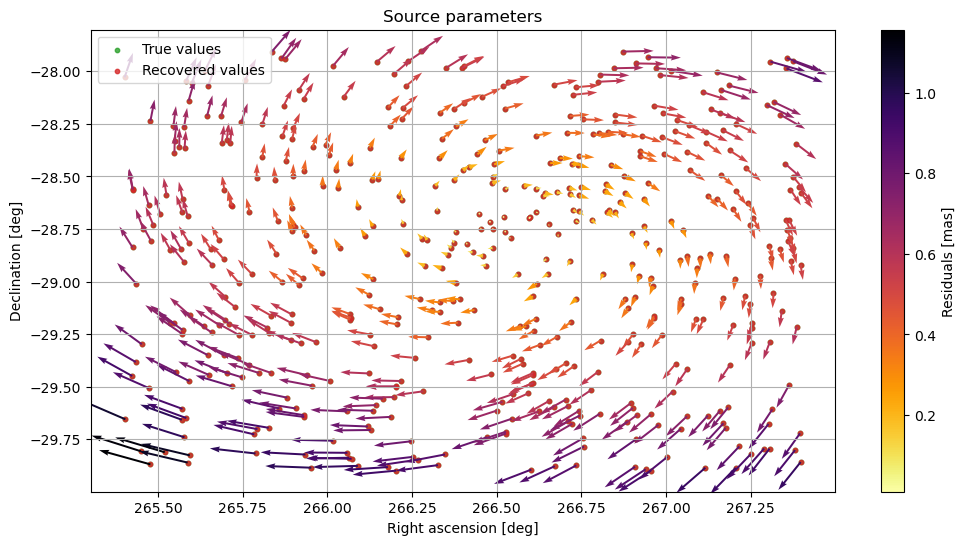

In [97]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=2e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

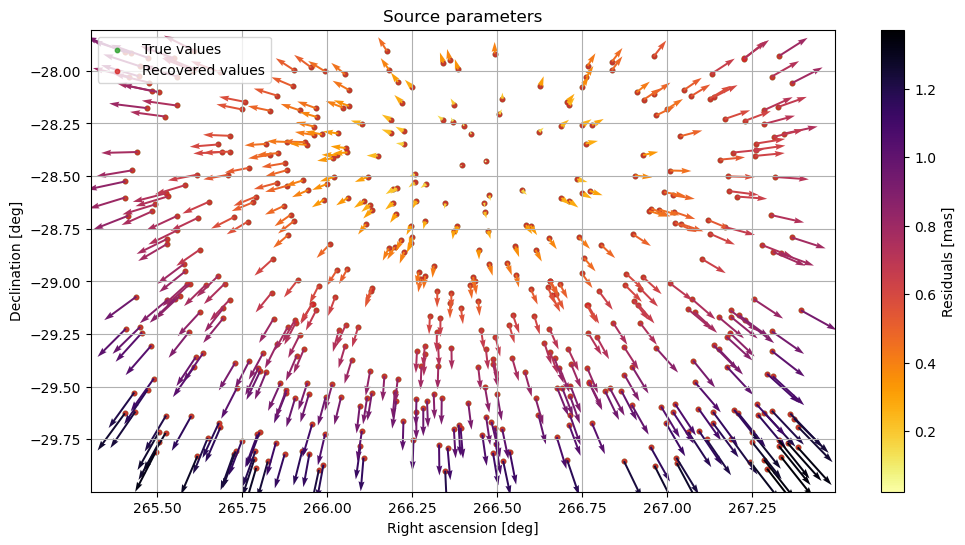

In [105]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=2e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

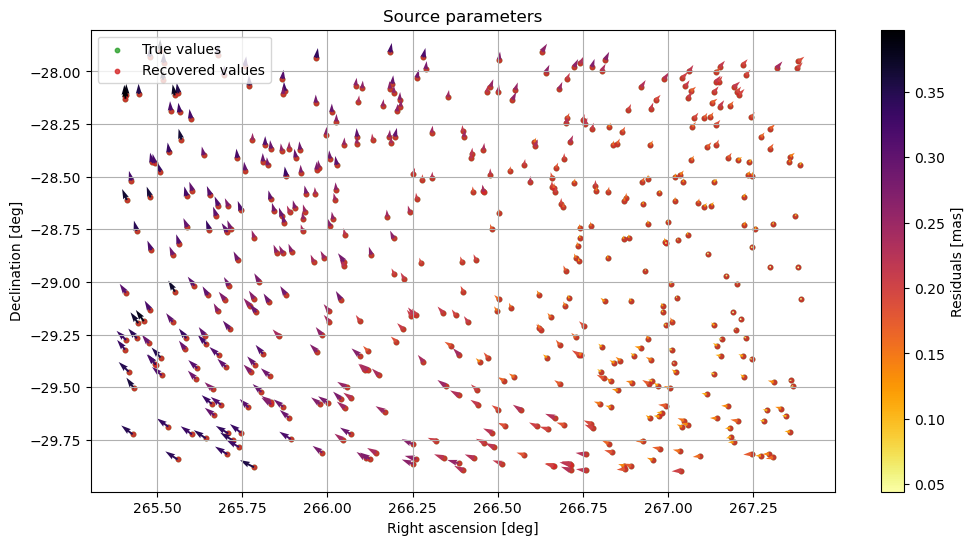

In [110]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=2e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

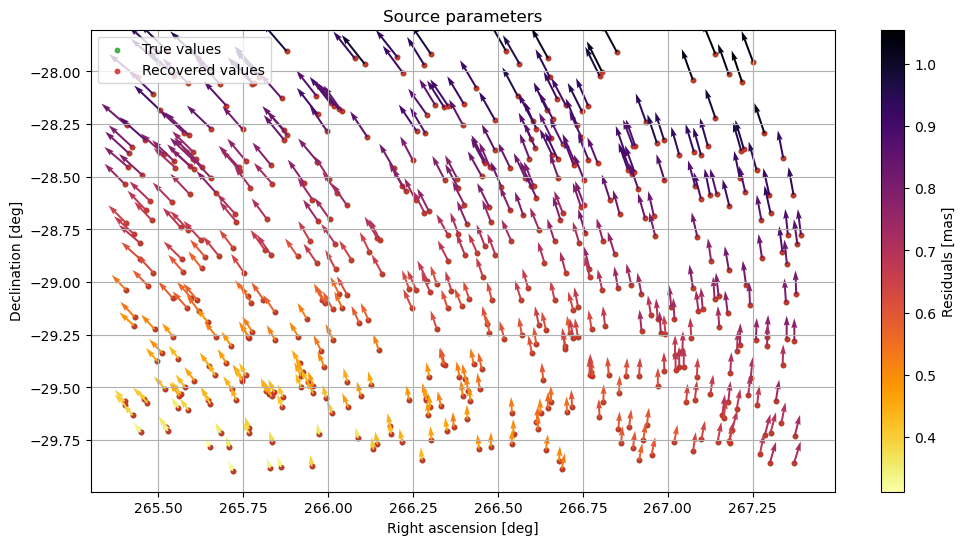

In [115]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=2e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

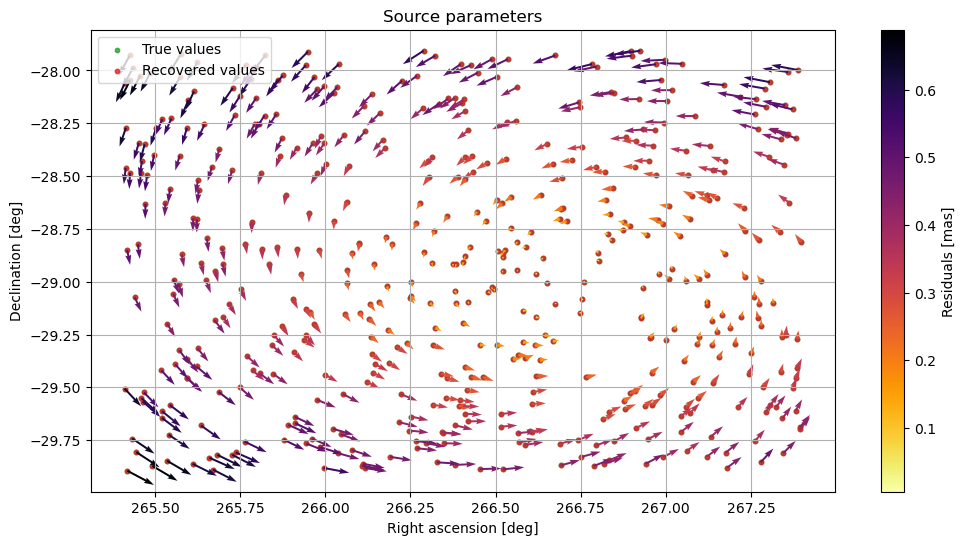

In [116]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=2e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

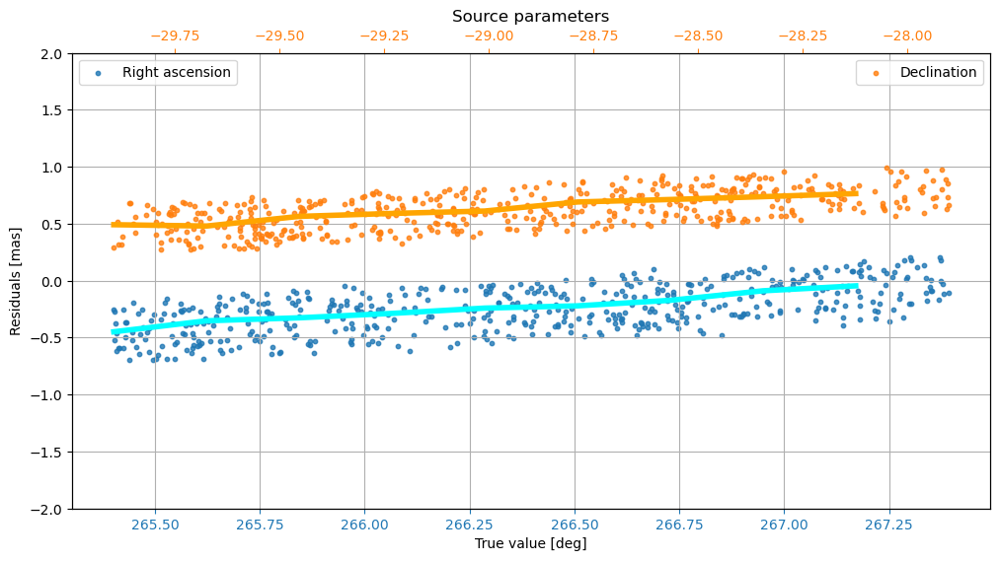

In [116]:
fig,ax = plt.subplots(figsize=(12,6))

ra_bins = np.linspace(np.min(src[:,1]),np.max(src[:,1]),10)
mean_ra_res,_,_ = scipy.stats.binned_statistic(src[:,1],(src_opt[:,1] - src[:,1])*_radiants_to_mas,bins=ra_bins)
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");
ax.plot(np.rad2deg(ra_bins[:-1]),mean_ra_res,color="cyan",lw=4)


ax2 = ax.twiny()

dec_bins = np.linspace(np.min(src[:,2]),np.max(src[:,2]),10)
mean_dec_res,_,_ = scipy.stats.binned_statistic(src[:,2],(src_opt[:,2] - src[:,2])*_radiants_to_mas,bins=dec_bins)
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");
ax2.plot(np.rad2deg(dec_bins[:-1]),mean_dec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-2,2);
ax.grid();

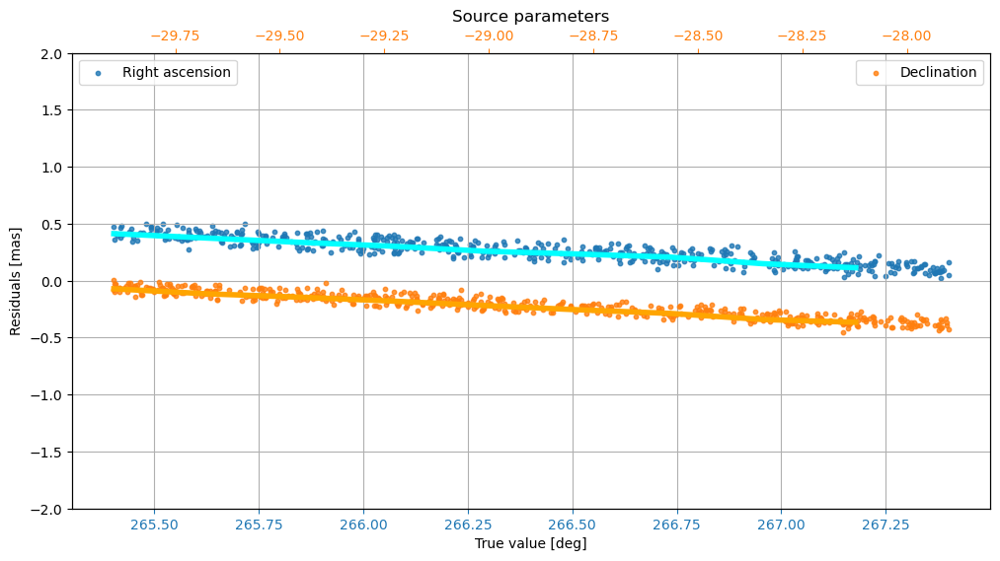

In [310]:
fig,ax = plt.subplots(figsize=(12,6))

ra_bins = np.linspace(np.min(src[:,1]),np.max(src[:,1]),10)
mean_ra_res,_,_ = scipy.stats.binned_statistic(src[:,1],(src_opt[:,1] - src[:,1])*_radiants_to_mas,bins=ra_bins)
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");
ax.plot(np.rad2deg(ra_bins[:-1]),mean_ra_res,color="cyan",lw=4,zorder=100)


ax2 = ax.twiny()

dec_bins = np.linspace(np.min(src[:,2]),np.max(src[:,2]),10)
mean_dec_res,_,_ = scipy.stats.binned_statistic(src[:,2],(src_opt[:,2] - src[:,2])*_radiants_to_mas,bins=dec_bins)
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");
ax2.plot(np.rad2deg(dec_bins[:-1]),mean_dec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-2,2);
ax.grid();

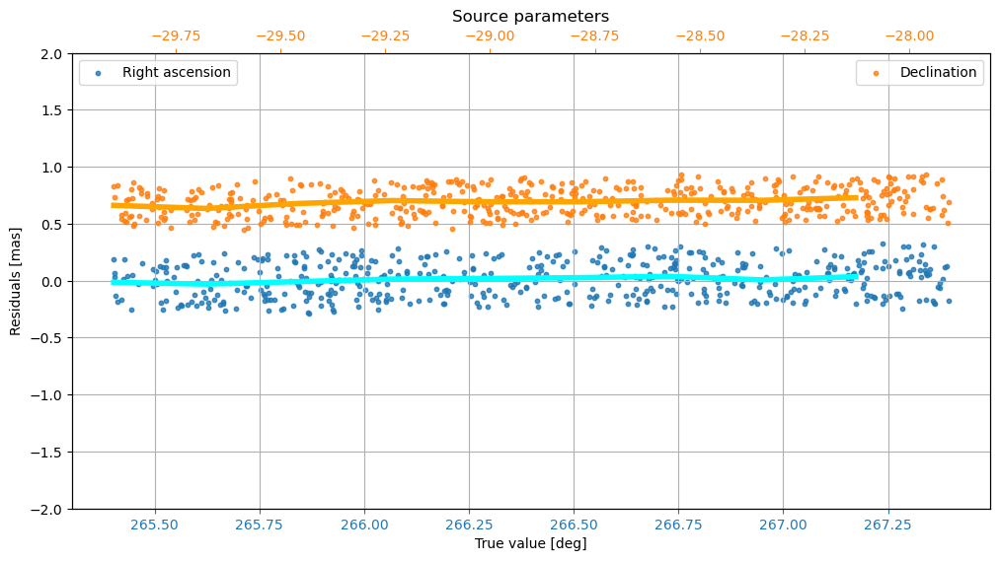

In [333]:
fig,ax = plt.subplots(figsize=(12,6))

ra_bins = np.linspace(np.min(src[:,1]),np.max(src[:,1]),10)
mean_ra_res,_,_ = scipy.stats.binned_statistic(src[:,1],(src_opt[:,1] - src[:,1])*_radiants_to_mas,bins=ra_bins)
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");
ax.plot(np.rad2deg(ra_bins[:-1]),mean_ra_res,color="cyan",lw=4,zorder=100)


ax2 = ax.twiny()

dec_bins = np.linspace(np.min(src[:,2]),np.max(src[:,2]),10)
mean_dec_res,_,_ = scipy.stats.binned_statistic(src[:,2],(src_opt[:,2] - src[:,2])*_radiants_to_mas,bins=dec_bins)
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");
ax2.plot(np.rad2deg(dec_bins[:-1]),mean_dec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-2,2);
ax.grid();

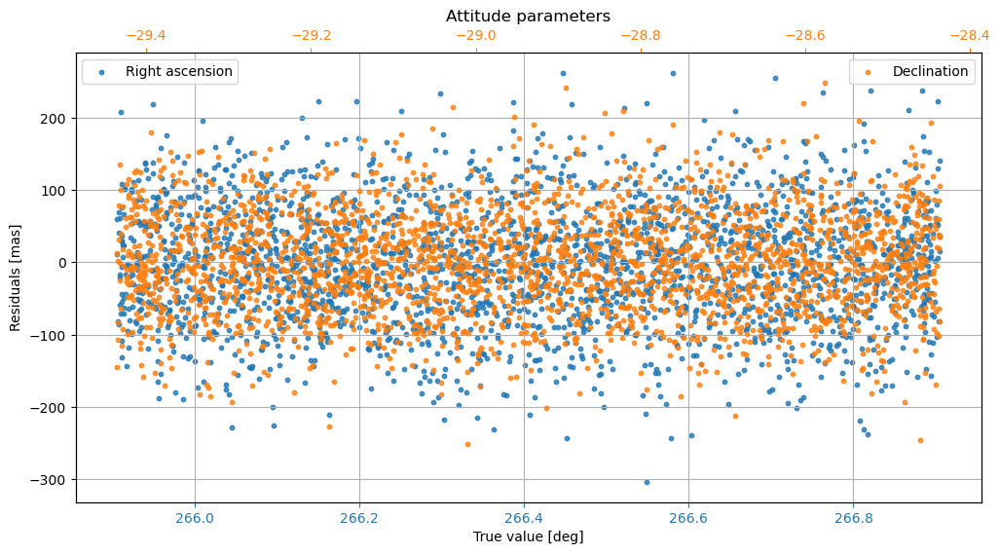

In [117]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

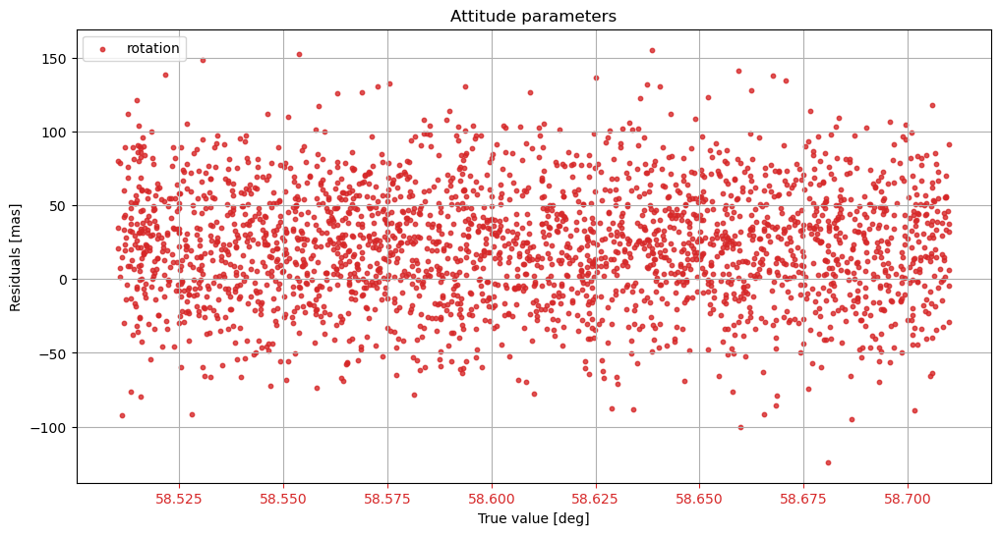

In [118]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

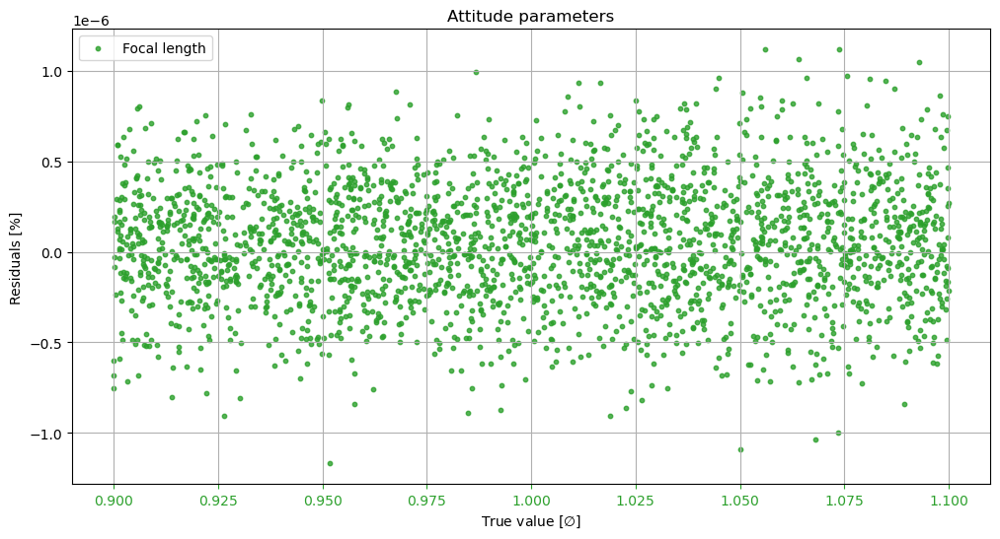

In [119]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

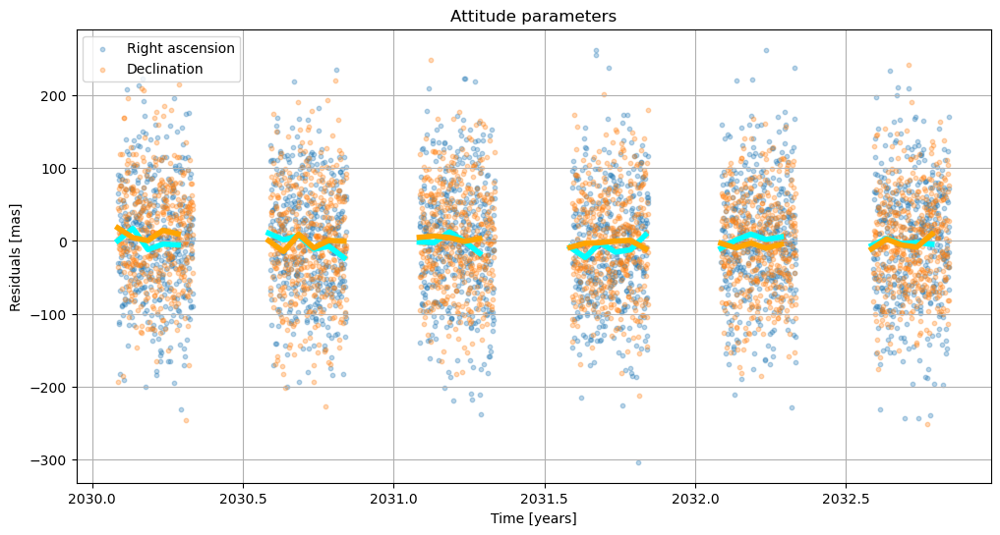

In [120]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

In [154]:
print(np.mean((att_opt[:,2] - att[:,2])*_radiants_to_mas),np.std((att_opt[:,2] - att[:,2])*_radiants_to_mas))

-2.601319673631944 80.59865772144131


In [155]:
print(np.mean((att_opt[:,3] - att[:,3])*_radiants_to_mas),np.std((att_opt[:,3] - att[:,3])*_radiants_to_mas))

-0.2086994277691851 70.06984511761995


In [125]:
print(np.mean((att_opt[:,4] - att[:,4])*_radiants_to_mas),np.std((att_opt[:,4] - att[:,4])*_radiants_to_mas))

22.636800273852856 39.13291818144433


In [151]:
print(np.mean((att_opt[:,5] - att[:,5])),np.std((att_opt[:,5] - att[:,5])))

4.8527120133835355e-08 3.3363804945452776e-07


#### Trying to de-rotate the result

In [148]:
rot = 0.01/_radiants_to_mas

#NOT GOOD! THE CENTER OF ROTATION IS NOT 0,0!
src_ra_derot = src_opt[:,1]*np.cos(rot) + src_opt[:,2]*np.sin(rot)
src_dec_derot = -src_opt[:,1]*np.sin(rot) + src_opt[:,2]*np.cos(rot)

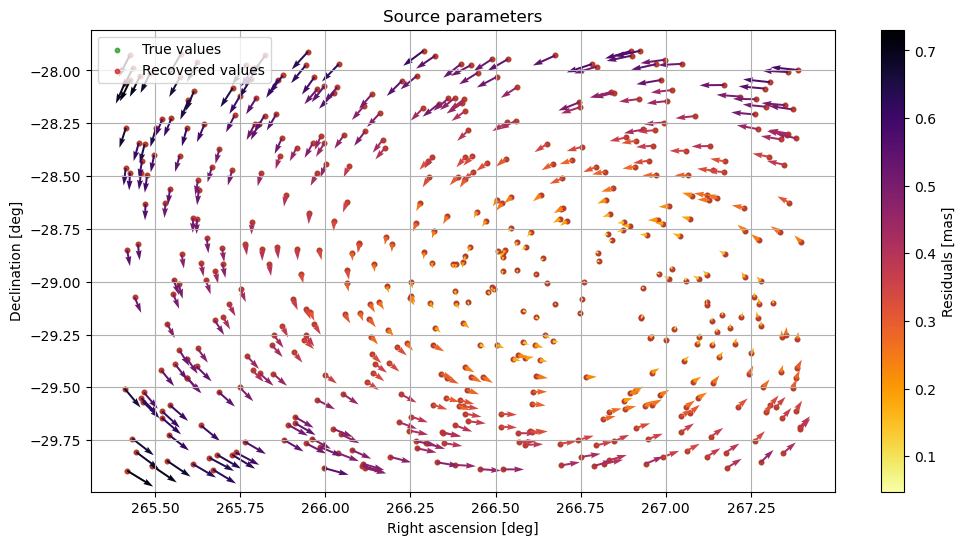

In [149]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_ra_derot-src[:,1]),np.rad2deg(src_dec_derot-src[:,2]),
          np.sqrt((src_ra_derot-src[:,1])**2+(src_dec_derot-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=2e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

### Test 3.2.5: same as 3.2.4 but x10 more sources

In [7]:
vel_dist = 100 #m/s

In [8]:
#PREAMBLE
import jasmine_frame as jf
t0 = Time('2030-02-01', scale='tcb') + np.linspace(0,3,10000) * units.year
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T
ephemeris = jnp.column_stack((pos,vel))
vel_true = vel + np.random.normal(0,scale=vel_dist,size=vel.shape)
ephemeris_true = jnp.column_stack((pos,vel_true))

#basic values
pkey = jax.random.PRNGKey(42)
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1

#check times of observation of this field
fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask = jasmine.observable(fov_centre)

#generate true values of the mock sources
source_id = jnp.arange(5000)
alpha0 = np.deg2rad(alpha00+np.random.uniform(-1.0, 1.0, size=source_id.shape))
delta0 = np.deg2rad(delta00+np.random.uniform(-1.0, 1.0, size=source_id.shape))

#generate true values of the attitude
ep = t0.decimalyear[observational_mask]
exposure_id = jnp.arange(len(ep))
pt_ra = np.deg2rad(pt_ra0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_dec = np.deg2rad(pt_dec0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_rot = np.deg2rad(pt_rot0 + np.random.uniform(-0.1,0.1, size=exposure_id.shape))
F = F0*np.random.uniform(0.9,1.1, size=exposure_id.shape)

#select corresponding ephemeris
ephis_true = ephemeris_true[observational_mask]
ephis = ephemeris[observational_mask]

src = np.stack([source_id, alpha0, delta0]).T
att = np.stack([exposure_id, ep, pt_ra,pt_dec,pt_rot,F]).T

#first guess
src_guess_error = 10/_radiants_to_mas #based on Gaia positional precision
att_guess_error = 1000/_radiants_to_mas

src_guess_errors = np.random.uniform(-src_guess_error, src_guess_error, size=src[:, 1:].shape)
shat = src + 0
shat[:,1:] = src[:,1:] + src_guess_errors

att_guess_errors = np.random.uniform(-att_guess_error, att_guess_error, size=att[:, 1:].shape)
ahat = att + 0
ahat[:,1:] = att[:,1:] + att_guess_errors

In [9]:
len(ep)

2495

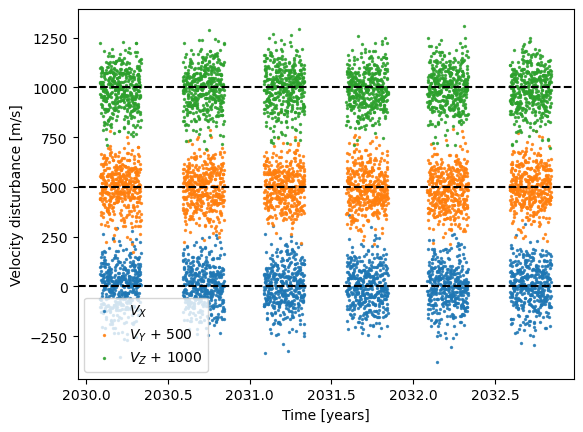

In [10]:
plt.scatter(att[:,1],ephis_true[:,3]-ephis[:,3],label=r"$V_X$",s=2,alpha=0.8)
plt.axhline(0,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,4]-ephis[:,4] + 500,label=r"$V_Y$ + 500",s=2,alpha=0.8)
plt.axhline(500,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,5]-ephis[:,5] + 2*500,label=r"$V_Z$ + 1000",s=2,alpha=0.8)
plt.axhline(2*500,color="k",ls="--")
plt.xlabel("Time [years]")
plt.ylabel("Velocity disturbance [m/s]")
plt.legend();

In [11]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))

In [12]:
sig_obs = 1/_radiants_to_mas
obs = generate_mock_obs_simple_wephemeris(src,att,None,ephis_true,model,sig_obs)

In [13]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model,1,1,1)

CPU times: user 9min 29s, sys: 12min 38s, total: 22min 8s
Wall time: 6min 24s


In [14]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.020020030050087657 0.12265073361321348 0.10217680493029946


In [15]:
print('{0:.2f}'.format(np.mean((src_opt[:,1] - src[:,1])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas)*1000),"\\muas")

-87.34 \muas & 122.65 \muas


In [16]:
print('{0:.2f}'.format(np.mean((src_opt[:,2] - src[:,2])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas)*1000),"\\muas")

153.40 \muas & 102.18 \muas


In [17]:
print('{0:.2f}'.format(np.mean((att_opt[:,2] - att[:,2])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((att_opt[:,2] - att[:,2])*_radiants_to_mas)),"mas")

-88.21 \muas & 79.43 mas


In [18]:
print('{0:.2f}'.format(np.mean((att_opt[:,3] - att[:,3])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((att_opt[:,3] - att[:,3])*_radiants_to_mas)),"mas")

2152.18 \muas & 69.97 mas


In [19]:
print('{0:.2f}'.format(np.mean((att_opt[:,4] - att[:,4])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((att_opt[:,4] - att[:,4])*_radiants_to_mas)),"mas")

-9226.03 \muas & 38.44 mas


In [20]:
print('%.2E' % Decimal(str(np.mean((att_opt[:,5] - att[:,5])))),'%.2E' % Decimal(str(np.std((att_opt[:,5] - att[:,5])))))

-4.94E-08 3.26E-07


#### Plotting residuals

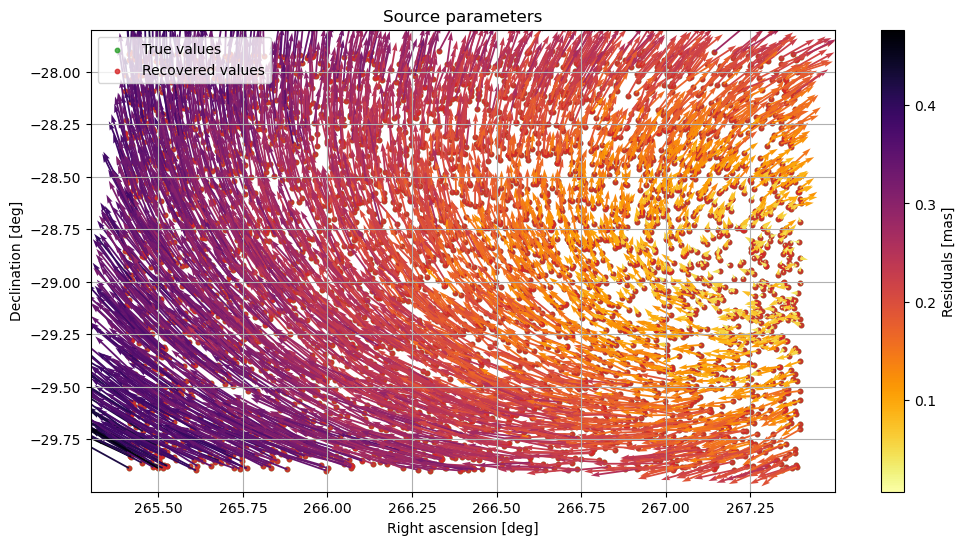

In [21]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=0.5e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

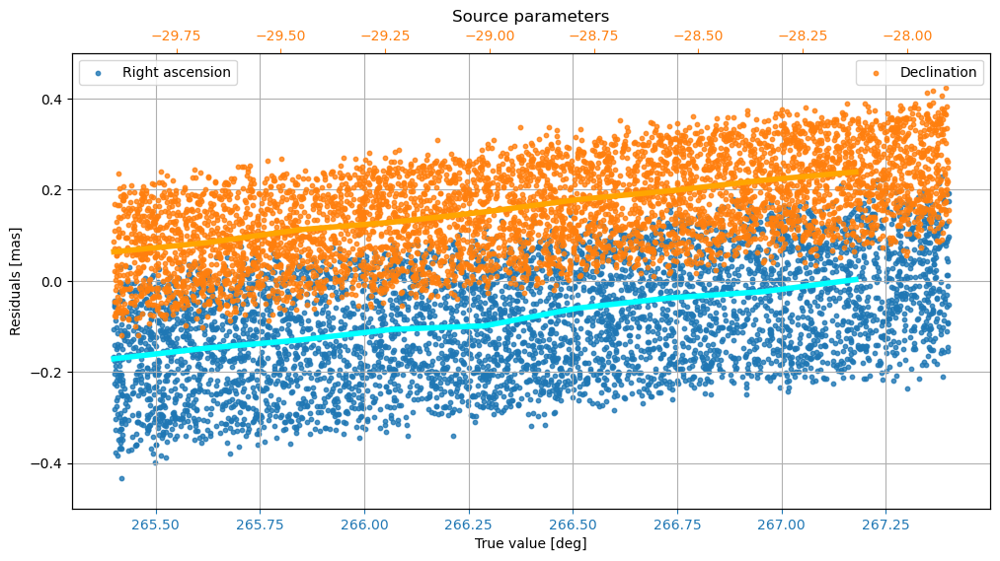

In [22]:
fig,ax = plt.subplots(figsize=(12,6))

ra_bins = np.linspace(np.min(src[:,1]),np.max(src[:,1]),10)
mean_ra_res,_,_ = scipy.stats.binned_statistic(src[:,1],(src_opt[:,1] - src[:,1])*_radiants_to_mas,bins=ra_bins)
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");
ax.plot(np.rad2deg(ra_bins[:-1]),mean_ra_res,color="cyan",lw=4,zorder=100)


ax2 = ax.twiny()

dec_bins = np.linspace(np.min(src[:,2]),np.max(src[:,2]),10)
mean_dec_res,_,_ = scipy.stats.binned_statistic(src[:,2],(src_opt[:,2] - src[:,2])*_radiants_to_mas,bins=dec_bins)
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");
ax2.plot(np.rad2deg(dec_bins[:-1]),mean_dec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-0.5,0.5);
ax.grid();

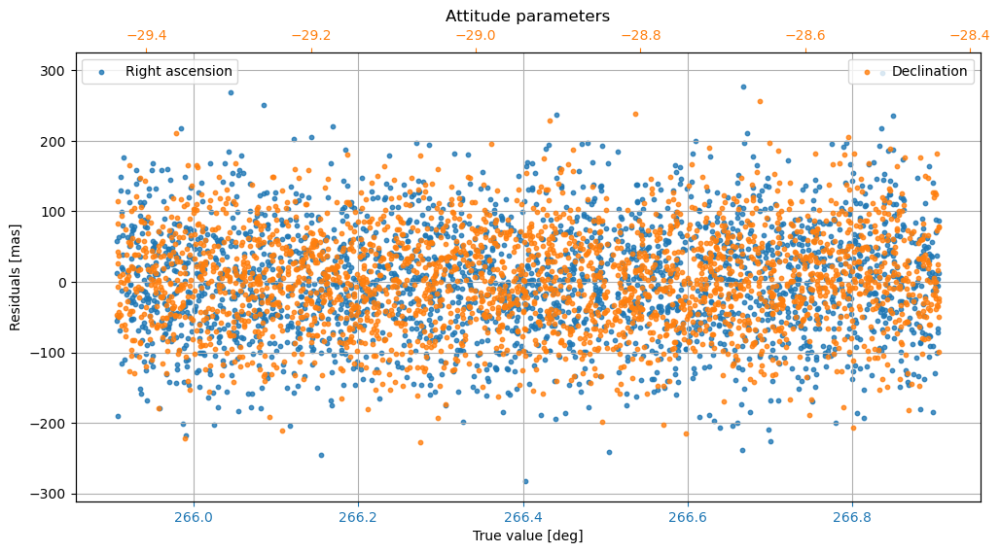

In [23]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

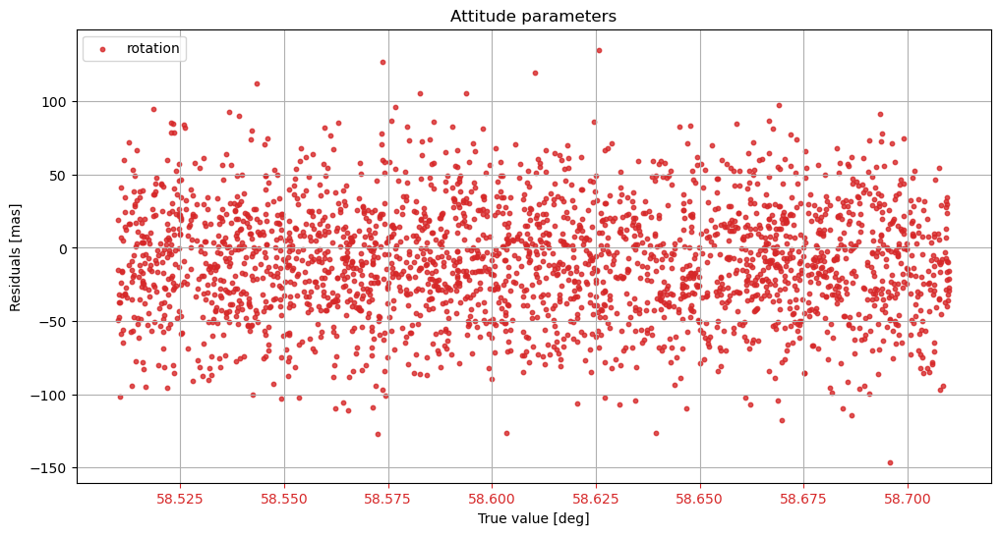

In [24]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

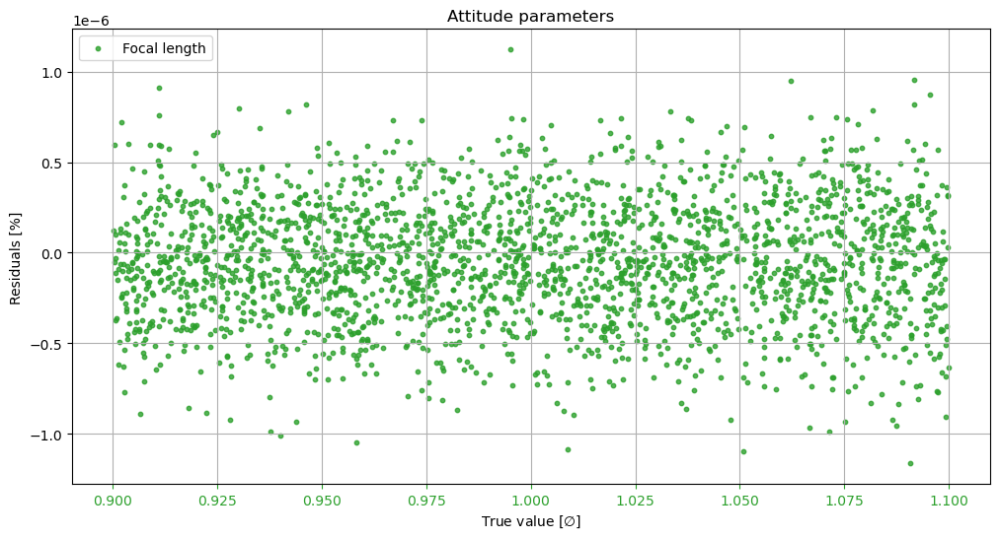

In [25]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

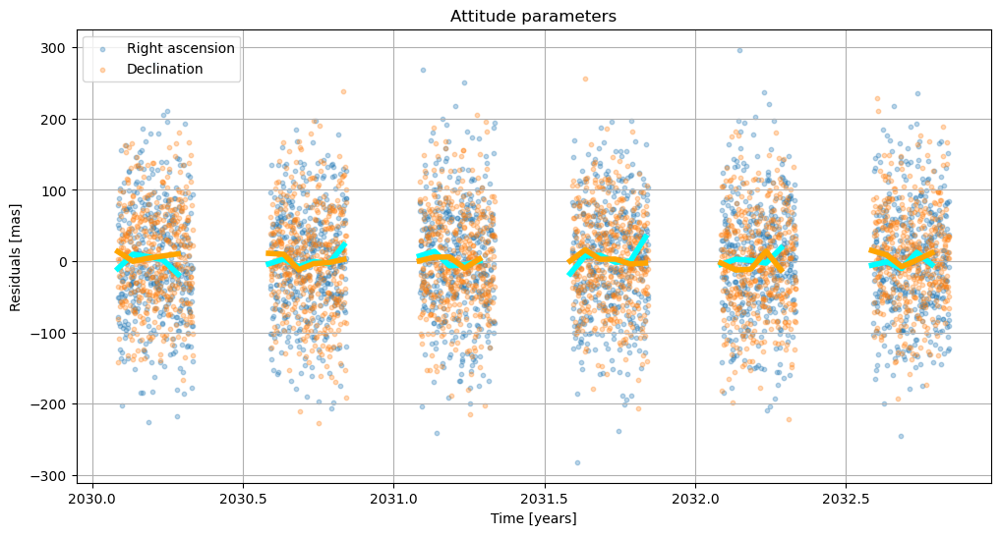

In [26]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

### Test 3.2.6: exact same setup (model parameters and observations) but trying to fit the velocity deviations

In [27]:
ahat_wdeltas = jnp.zeros((ahat.shape[0],ahat.shape[1]+3))
ahat_wdeltas = ahat_wdeltas.at[:,:-3].add(ahat)

In [28]:
model_wdeltas = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi,_deltavx=a[4],_deltavy=a[5],_deltavz=a[6]),a[0],a[1],a[2]),a[3])))

In [29]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat_wdeltas,None,ephis,obs,model_wdeltas,1,1,1)

CPU times: user 9min 35s, sys: 12min 37s, total: 22min 13s
Wall time: 6min 24s


In [30]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.020020030050087657 0.16903340197537528 0.16236275147954427


In [31]:
print('{0:.2f}'.format(np.mean((src_opt[:,1] - src[:,1])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas)*1000),"\\muas")

-92.79 \muas & 169.03 \muas


In [32]:
print('{0:.2f}'.format(np.mean((src_opt[:,2] - src[:,2])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas)*1000),"\\muas")

151.42 \muas & 162.36 \muas


In [33]:
print('{0:.2f}'.format(np.mean((att_opt[:,2] - att[:,2])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((att_opt[:,2] - att[:,2])*_radiants_to_mas)),"mas")

-65398.37 \muas & 243.59 mas


In [34]:
print('{0:.2f}'.format(np.mean((att_opt[:,3] - att[:,3])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((att_opt[:,3] - att[:,3])*_radiants_to_mas)),"mas")

47866.63 \muas & 289.67 mas


In [35]:
print('{0:.2f}'.format(np.mean((att_opt[:,4] - att[:,4])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((att_opt[:,4] - att[:,4])*_radiants_to_mas)),"mas")

-40423.60 \muas & 118.13 mas


In [36]:
print('%.2E' % Decimal(str(np.mean((att_opt[:,5] - att[:,5])))),'%.2E' % Decimal(str(np.std((att_opt[:,5] - att[:,5])))))

4.18E-05 2.64E-04


In [45]:
print('{0:.2f}'.format(np.mean(att_opt[:,6])),"\\ms &",'{0:.2f}'.format(np.std(att_opt[:,6])),"\\ms")

-471.48 \ms & 4335.14 \ms


In [46]:
print('{0:.2f}'.format(np.mean(att_opt[:,7])),"\\ms &",'{0:.2f}'.format(np.std(att_opt[:,7])),"\\ms")

-10973.26 \ms & 68769.88 \ms


In [47]:
print('{0:.2f}'.format(np.mean(att_opt[:,8])),"\\ms &",'{0:.2f}'.format(np.std(att_opt[:,8])),"\\ms")

-6071.05 \ms & 38459.14 \ms


#### Plotting residuals

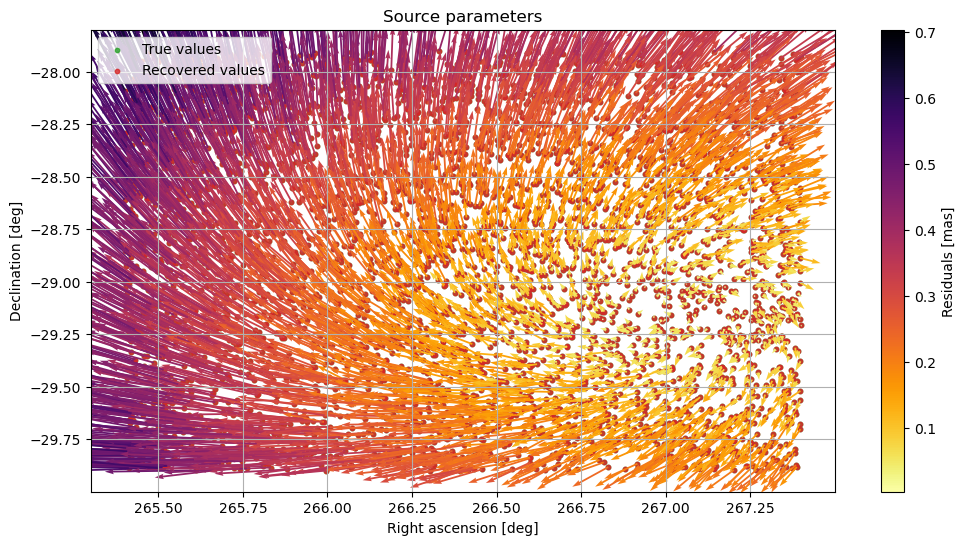

In [37]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=0.5e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

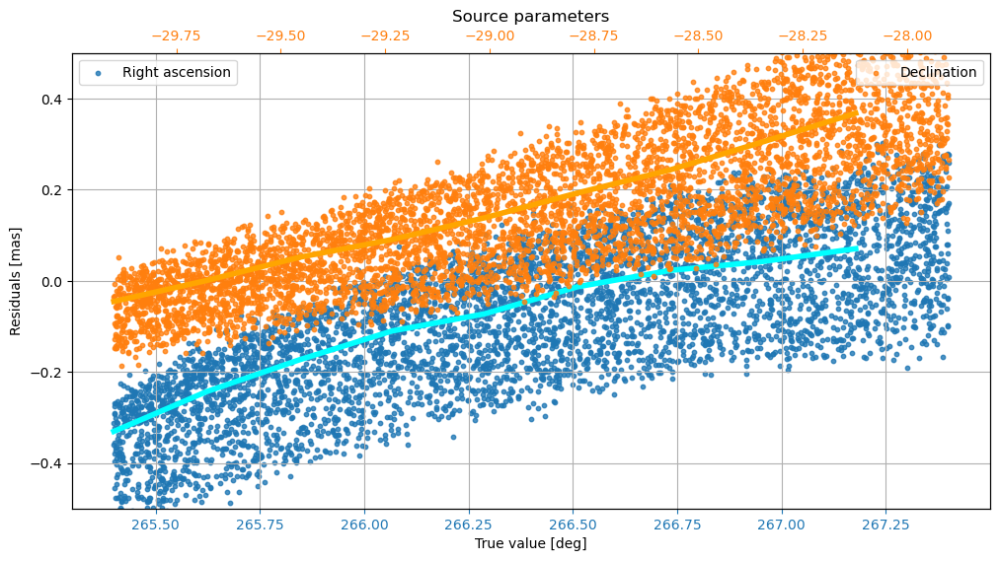

In [38]:
fig,ax = plt.subplots(figsize=(12,6))

ra_bins = np.linspace(np.min(src[:,1]),np.max(src[:,1]),10)
mean_ra_res,_,_ = scipy.stats.binned_statistic(src[:,1],(src_opt[:,1] - src[:,1])*_radiants_to_mas,bins=ra_bins)
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");
ax.plot(np.rad2deg(ra_bins[:-1]),mean_ra_res,color="cyan",lw=4,zorder=100)


ax2 = ax.twiny()

dec_bins = np.linspace(np.min(src[:,2]),np.max(src[:,2]),10)
mean_dec_res,_,_ = scipy.stats.binned_statistic(src[:,2],(src_opt[:,2] - src[:,2])*_radiants_to_mas,bins=dec_bins)
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");
ax2.plot(np.rad2deg(dec_bins[:-1]),mean_dec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-0.5,0.5);
ax.grid();

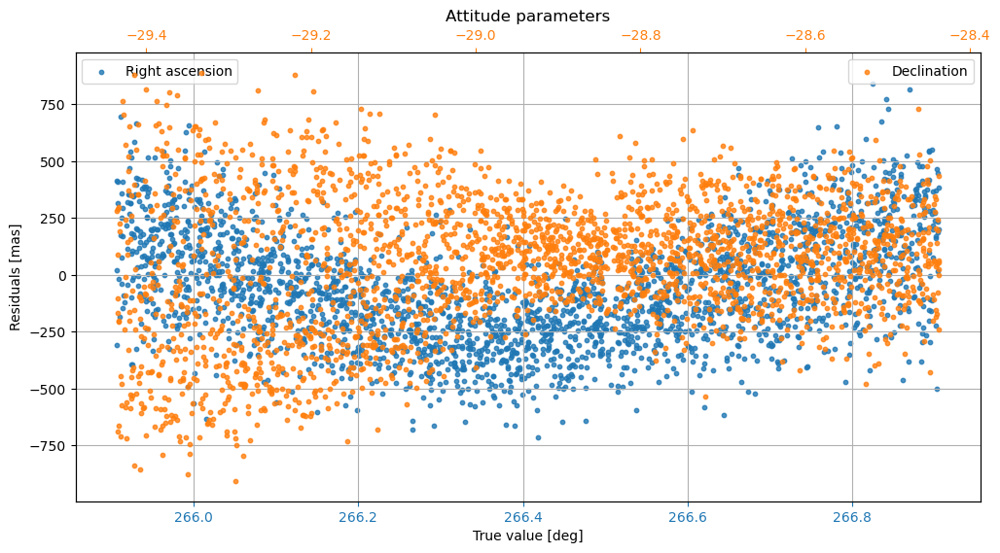

In [39]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

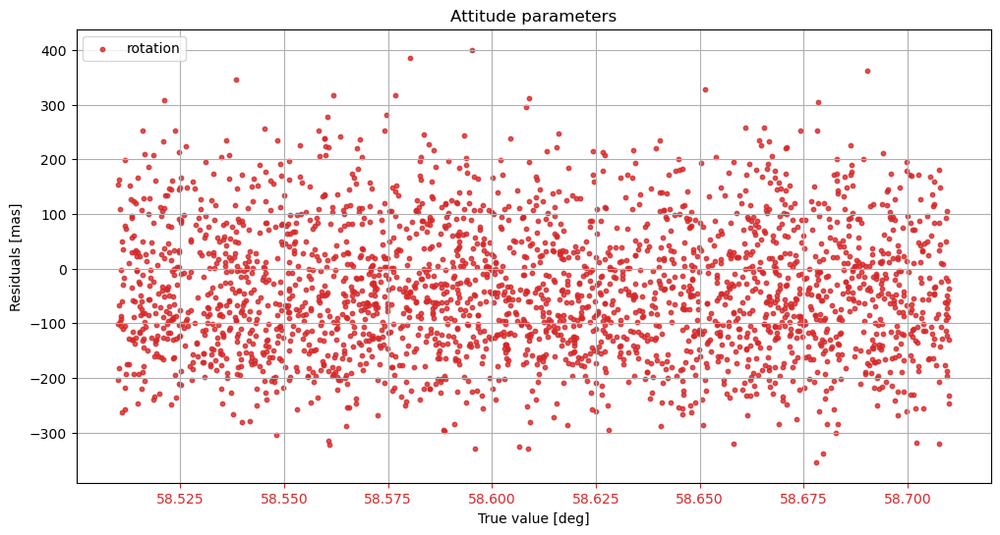

In [40]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

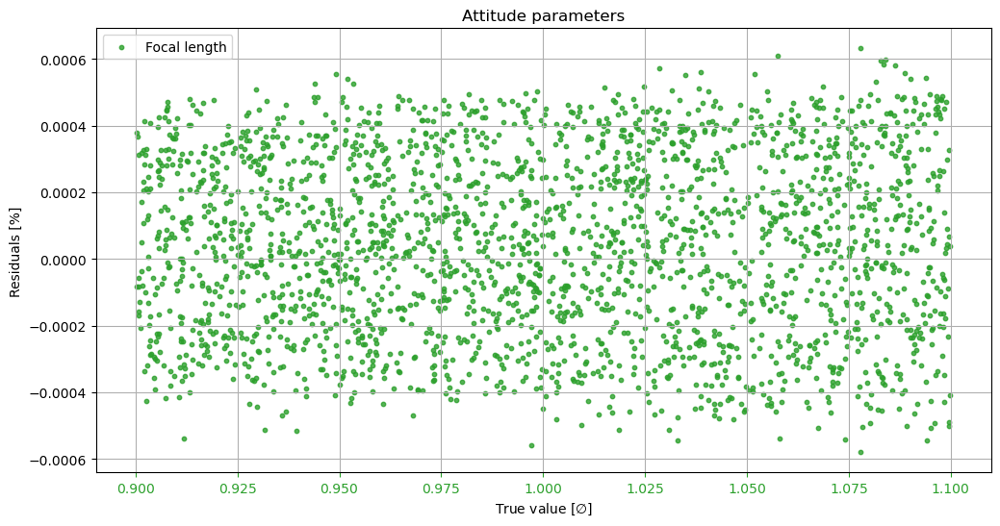

In [41]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

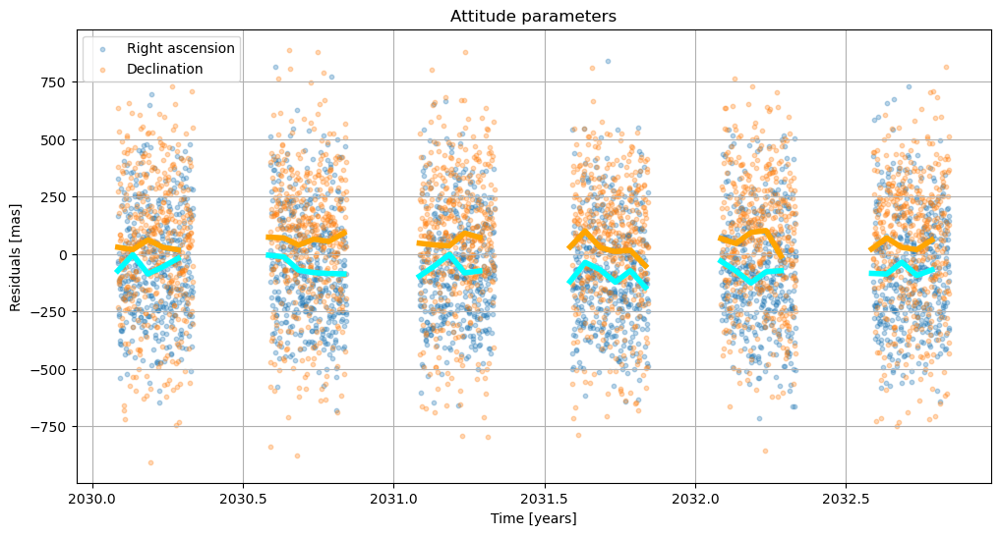

In [42]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

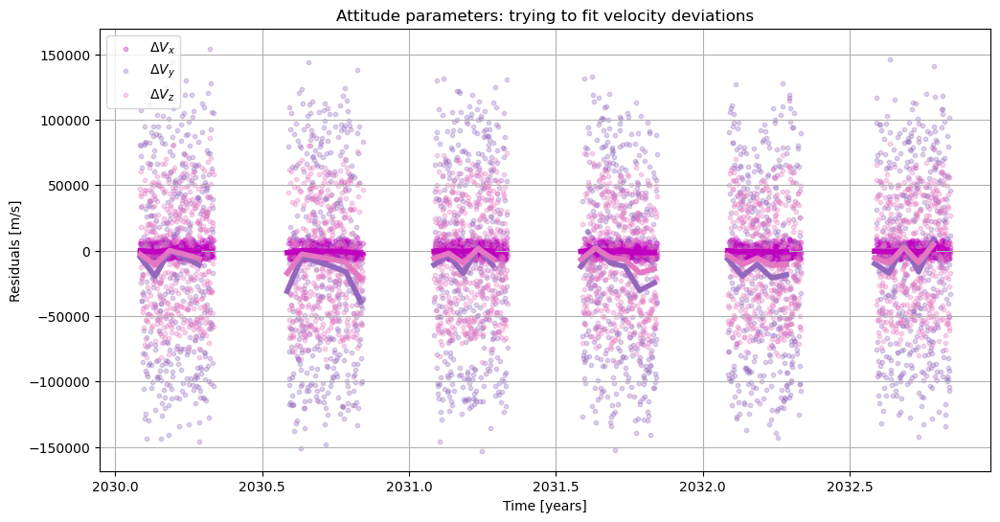

In [43]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_Dvx_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,-3]),bins=t_bins)
mean_Dvy_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,-2]),bins=t_bins)
mean_Dvz_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,-1]),bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],att_opt[:,-3],label=r"$\Delta V_x$",s=10,alpha=0.3,color="m");
ax.scatter(att[:,1],att_opt[:,-2],label=r"$\Delta V_y$",s=10,alpha=0.3,color="tab:purple");
ax.scatter(att[:,1],att_opt[:,-1],label=r"$\Delta V_z$",s=10,alpha=0.3,color="tab:pink");

ax.plot(t_bins[:-1],mean_Dvx_res,color="m",lw=4)
ax.plot(t_bins[:-1],mean_Dvy_res,color="tab:purple",lw=4)
ax.plot(t_bins[:-1],mean_Dvz_res,color="tab:pink",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [m/s]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters: trying to fit velocity deviations")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

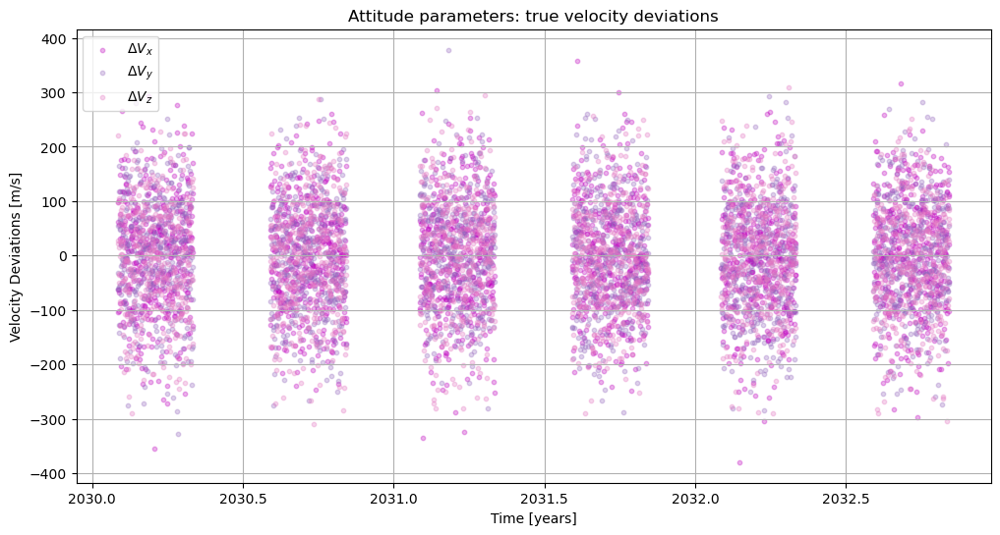

In [44]:
t_bins = np.arange(ep[0],ep[-1],0.05)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(vel_true[observational_mask,0]-vel[observational_mask,0]),label=r"$\Delta V_x$",s=10,alpha=0.3,color="m");
ax.scatter(att[:,1],(vel_true[observational_mask,1]-vel[observational_mask,1]),label=r"$\Delta V_y$",s=10,alpha=0.3,color="tab:purple");
ax.scatter(att[:,1],(vel_true[observational_mask,2]-vel[observational_mask,2]),label=r"$\Delta V_z$",s=10,alpha=0.3,color="tab:pink");

ax.legend(loc="upper left")
ax.set_ylabel("Velocity Deviations [m/s]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters: true velocity deviations")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

### Test 3.2.7: same as 3.2.5 but x10 bigger velocity deviations

In [184]:
vel_dist = 1000 #m/s

In [185]:
#PREAMBLE
import jasmine_frame as jf
t0 = Time('2030-02-01', scale='tcb') + np.linspace(0,3,10000) * units.year
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T
ephemeris = jnp.column_stack((pos,vel))
vel_true = vel + np.random.normal(0,scale=vel_dist,size=vel.shape)
ephemeris_true = jnp.column_stack((pos,vel_true))

#basic values
pkey = jax.random.PRNGKey(42)
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1

#check times of observation of this field
fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask = jasmine.observable(fov_centre)

#generate true values of the mock sources
source_id = jnp.arange(5000)
alpha0 = np.deg2rad(alpha00+np.random.uniform(-1.0, 1.0, size=source_id.shape))
delta0 = np.deg2rad(delta00+np.random.uniform(-1.0, 1.0, size=source_id.shape))

#generate true values of the attitude
ep = t0.decimalyear[observational_mask]
exposure_id = jnp.arange(len(ep))
pt_ra = np.deg2rad(pt_ra0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_dec = np.deg2rad(pt_dec0 + np.random.uniform(-0.5, 0.5, size=exposure_id.shape))
pt_rot = np.deg2rad(pt_rot0 + np.random.uniform(-0.1,0.1, size=exposure_id.shape))
F = F0*np.random.uniform(0.9,1.1, size=exposure_id.shape)

#select corresponding ephemeris
ephis_true = ephemeris_true[observational_mask]
ephis = ephemeris[observational_mask]

src = np.stack([source_id, alpha0, delta0]).T
att = np.stack([exposure_id, ep, pt_ra,pt_dec,pt_rot,F]).T

#first guess
src_guess_error = 10/_radiants_to_mas #based on Gaia positional precision
att_guess_error = 1000/_radiants_to_mas

src_guess_errors = np.random.uniform(-src_guess_error, src_guess_error, size=src[:, 1:].shape)
shat = src + 0
shat[:,1:] = src[:,1:] + src_guess_errors

att_guess_errors = np.random.uniform(-att_guess_error, att_guess_error, size=att[:, 1:].shape)
ahat = att + 0
ahat[:,1:] = att[:,1:] + att_guess_errors

In [186]:
len(ep)

2495

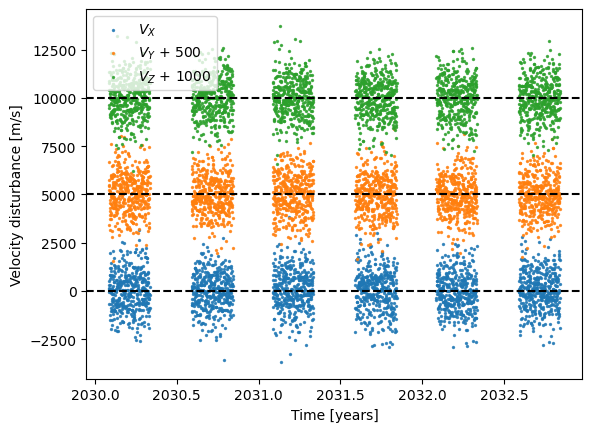

In [187]:
plt.scatter(att[:,1],ephis_true[:,3]-ephis[:,3],label=r"$V_X$",s=2,alpha=0.8)
plt.axhline(0,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,4]-ephis[:,4] + 5000,label=r"$V_Y$ + 500",s=2,alpha=0.8)
plt.axhline(5000,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,5]-ephis[:,5] + 2*5000,label=r"$V_Z$ + 1000",s=2,alpha=0.8)
plt.axhline(2*5000,color="k",ls="--")
plt.xlabel("Time [years]")
plt.ylabel("Velocity disturbance [m/s]")
plt.legend();

In [188]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))

In [189]:
sig_obs = 1/_radiants_to_mas
obs = generate_mock_obs_simple_wephemeris(src,att,None,ephis_true,model,sig_obs)

In [190]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model,1,1,1)

CPU times: user 9min 49s, sys: 13min 21s, total: 23min 11s
Wall time: 6min 50s


In [191]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(ep)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.020020030050087657 0.06212300617291075 0.05742944458003904


In [214]:
print('{0:.2f}'.format(np.mean((src_opt[:,1] - src[:,1])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas)*1000),"\\muas")

-27.21 \muas & 62.12 \muas


In [210]:
print('{0:.2f}'.format(np.mean((src_opt[:,2] - src[:,2])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas)*1000),"\\muas")

25.30 \muas & 57.43 \muas


In [218]:
print('{0:.2f}'.format(np.mean((att_opt[:,2] - att[:,2])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((att_opt[:,2] - att[:,2])*_radiants_to_mas)),"mas")

1877.13 \muas & 786.96 mas


In [219]:
print('{0:.2f}'.format(np.mean((att_opt[:,3] - att[:,3])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((att_opt[:,3] - att[:,3])*_radiants_to_mas)),"mas")

-9724.70 \muas & 691.87 mas


In [220]:
print('{0:.2f}'.format(np.mean((att_opt[:,4] - att[:,4])*_radiants_to_mas)*1000),"\\muas &",'{0:.2f}'.format(np.std((att_opt[:,4] - att[:,4])*_radiants_to_mas)),"mas")

-1572.76 \muas & 380.40 mas


In [207]:
print('%.2E' % Decimal(str(np.mean((att_opt[:,5] - att[:,5])))),'%.2E' % Decimal(str(np.std((att_opt[:,5] - att[:,5])))))

4.11E-08 3.39E-06


#### Plotting residuals

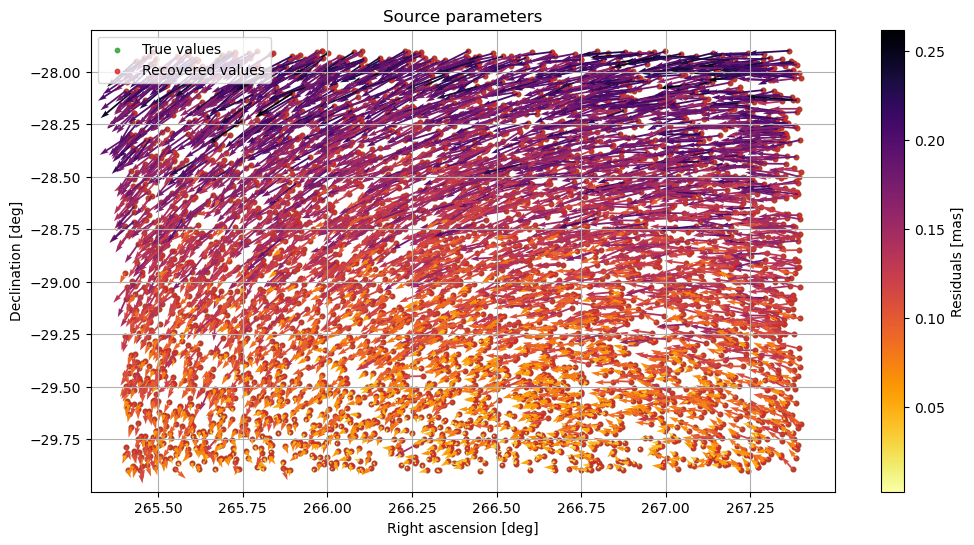

In [168]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=0.5e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

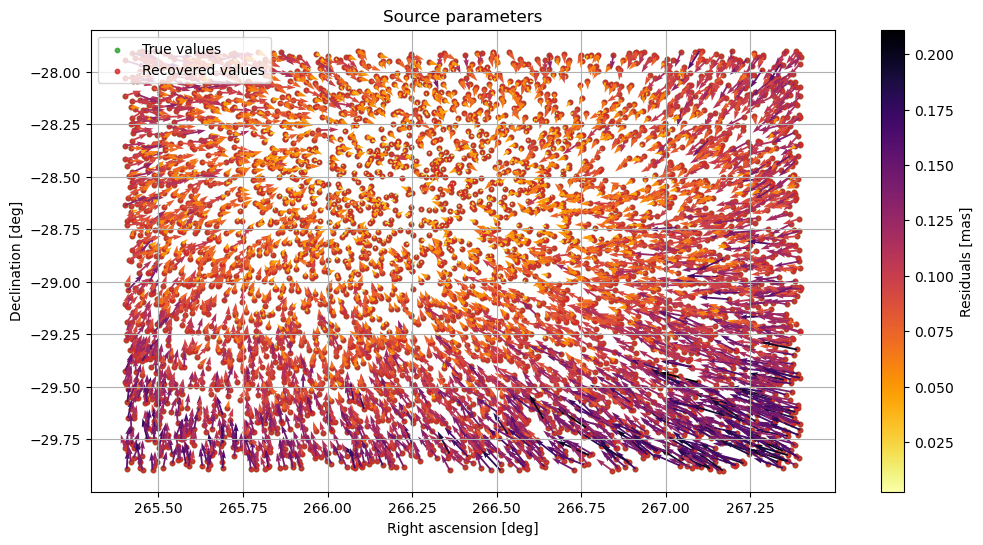

In [198]:
fig,ax = plt.subplots(figsize=(12,6))
ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),label="True values",s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[:,1]),np.rad2deg(src_opt[:,2]),label="Recovered values",s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),
          np.rad2deg(src_opt[:,1]-src[:,1]),np.rad2deg(src_opt[:,2]-src[:,2]),
          np.sqrt((src_opt[:,1]-src[:,1])**2+(src_opt[:,2]-src[:,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=0.5e-6);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

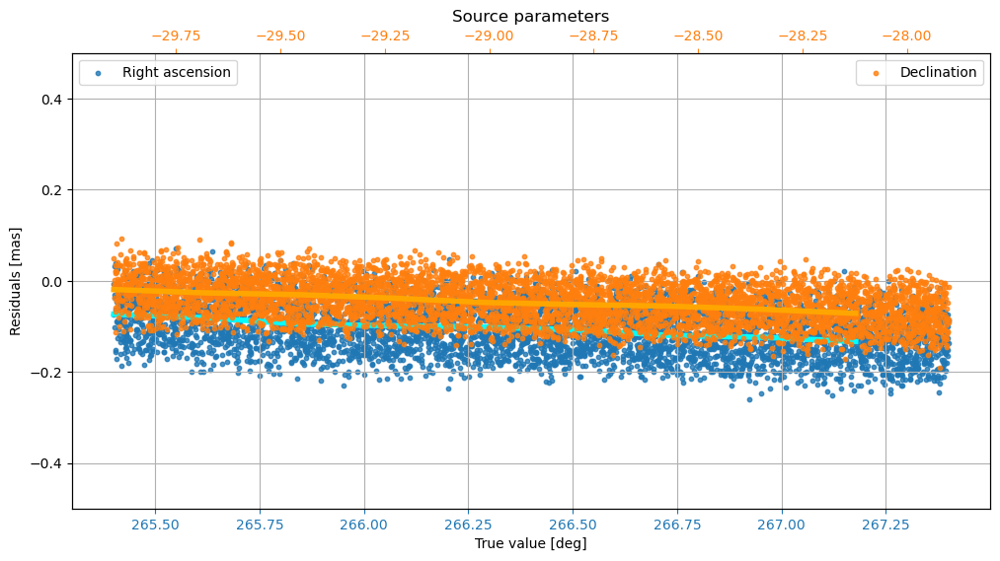

In [169]:
fig,ax = plt.subplots(figsize=(12,6))

ra_bins = np.linspace(np.min(src[:,1]),np.max(src[:,1]),10)
mean_ra_res,_,_ = scipy.stats.binned_statistic(src[:,1],(src_opt[:,1] - src[:,1])*_radiants_to_mas,bins=ra_bins)
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");
ax.plot(np.rad2deg(ra_bins[:-1]),mean_ra_res,color="cyan",lw=4,zorder=100)


ax2 = ax.twiny()

dec_bins = np.linspace(np.min(src[:,2]),np.max(src[:,2]),10)
mean_dec_res,_,_ = scipy.stats.binned_statistic(src[:,2],(src_opt[:,2] - src[:,2])*_radiants_to_mas,bins=dec_bins)
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");
ax2.plot(np.rad2deg(dec_bins[:-1]),mean_dec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-0.5,0.5);
ax.grid();

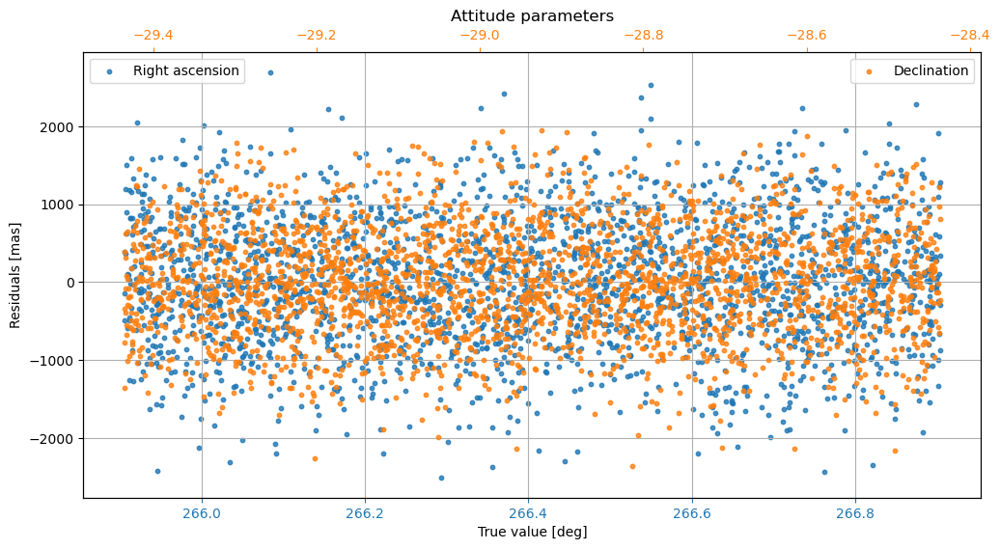

In [170]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

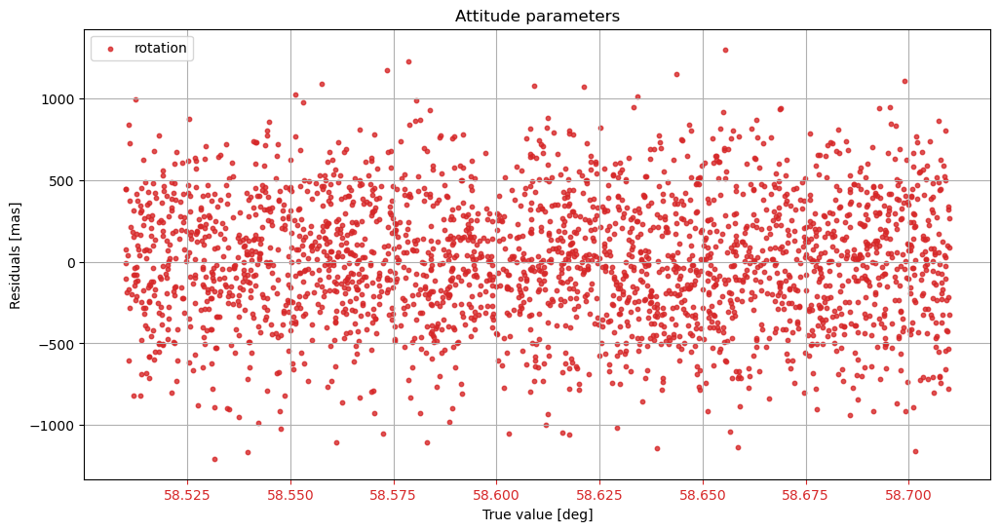

In [171]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

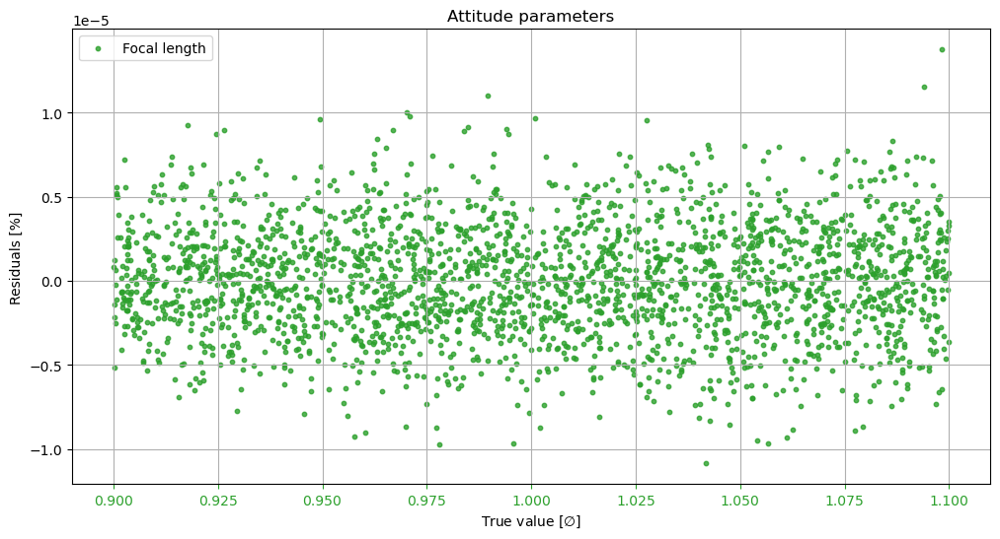

In [172]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

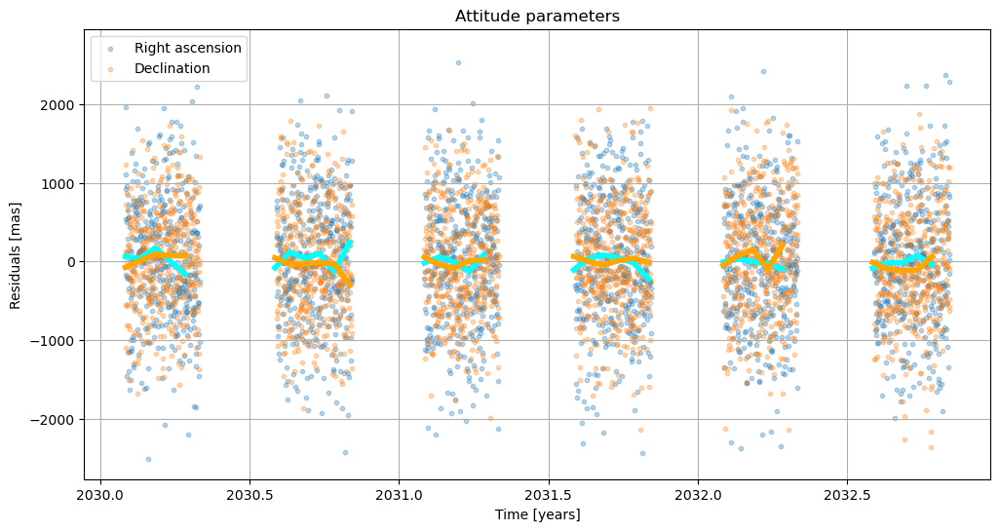

In [173]:
t_bins = np.arange(ep[0],ep[-1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

## Test 3.3: trying with mutiple FoVs 

### Test 3.3.1: similar to 3.2.5

In [6]:
vel_dist = 100 #m/s

In [7]:
#basic values
alpha00 = 266.4
delta00 = -28.9
pt_ra0 = 266.40498829
pt_dec0 = -28.93617776
pt_rot0 = 58.61
F0 = 1
FoV = 0.5 #degrees


import jasmine_frame as jf
observation_day = np.arange(0,3*365*24*60,10)*units.minute
jasmine_aux = jf.JASMINEFrame(obstime=Time('2030-02-01', scale='tcb') + observation_day).with_updated_phase()

fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask0 = jasmine_aux.observable(fov_centre)

observation_times = np.hstack([d + np.linspace(-10,10,4)*units.minute for d in observation_day[observational_mask0][100:-100:40]])
t0 = Time('2030-02-01', scale='tcb') + observation_times
jasmine = jf.JASMINEFrame(obstime=t0).with_updated_phase()
fov_centre = coord.SkyCoord(pt_ra0 * units.deg, pt_dec0 * units.deg)
observational_mask = jasmine.observable(fov_centre)

#PREAMBLE
pos = jasmine.obsbaryloc.xyz.to('au').value.T
vel = jasmine.obsbaryvel.xyz.to(units.meter/units.second).value.T
ephemeris = jnp.column_stack((pos,vel))
vel_true = vel + np.random.normal(0,scale=vel_dist,size=vel.shape)
ephemeris_true = jnp.column_stack((pos,vel_true))

ephis_true = ephemeris_true#[observational_mask]
ephis = ephemeris#[observational_mask]


#simulate stars
sky_patch_size = 2
source_id = np.arange(5000)
alpha0 = np.deg2rad(alpha00 + np.random.uniform(-sky_patch_size/2, sky_patch_size/2, size=source_id.shape))
delta0 = np.deg2rad(delta00 + np.random.uniform(-sky_patch_size/2, sky_patch_size/2, size=source_id.shape))

fovs = [
    [(pt_ra0-0.2,pt_dec0+0),pt_rot0,F0,FoV],
    [(pt_ra0+0.2,pt_dec0+0),pt_rot0,F0,FoV],
    [(pt_ra0+0,pt_dec0-0.2),pt_rot0,F0,FoV],
    [(pt_ra0+0,pt_dec0+0.2),pt_rot0,F0,FoV]
]

atts = []
FoV_sizes = []
last_exp_id = 0
for i,buffer in enumerate(fovs):
    fov_loc,fov_rot,fov_F,fov_size = buffer
    time_ = t0[i::4].decimalyear
    exposure_id_ = last_exp_id + jnp.arange(len(time_))
    pt_ra_ = np.deg2rad(fov_loc[0] + np.random.uniform(-fov_size/5, fov_size/5, size=exposure_id_.shape))
    pt_dec_ = np.deg2rad(fov_loc[1] + np.random.uniform(-fov_size/5, fov_size/5, size=exposure_id_.shape))
    pt_rot_ = np.deg2rad(fov_rot + np.random.uniform(-0.1,0.1, size=exposure_id_.shape))
    F_ = fov_F*np.random.uniform(0.9,1.1, size=exposure_id_.shape)
    att_ = np.stack([exposure_id_, time_, pt_ra_,pt_dec_,pt_rot_,F_]).T
    atts.append(att_)
    last_exp_id = exposure_id_[-1] + 1
    fs_ = np.deg2rad(fov_size)*np.ones(exposure_id_.size)
    FoV_sizes.append(fs_)

src = np.stack([source_id, alpha0, delta0]).T
att = np.vstack((atts))
FoV_sizes = np.hstack(FoV_sizes)

In [ ]:
np.sum(observational_mask)

In [8]:
#first guess
src_guess_error = 10/_radiants_to_mas #based on Gaia positional precision
att_guess_error = 1000/_radiants_to_mas

src_guess_errors = np.random.uniform(-src_guess_error, src_guess_error, size=src[:, 1:].shape)
shat = src + 0
shat[:,1:] = src[:,1:] + src_guess_errors

att_guess_errors = np.random.uniform(-att_guess_error, att_guess_error, size=att[:, 1:].shape)
ahat = att + 0
ahat[:,1:] = att[:,1:] + att_guess_errors

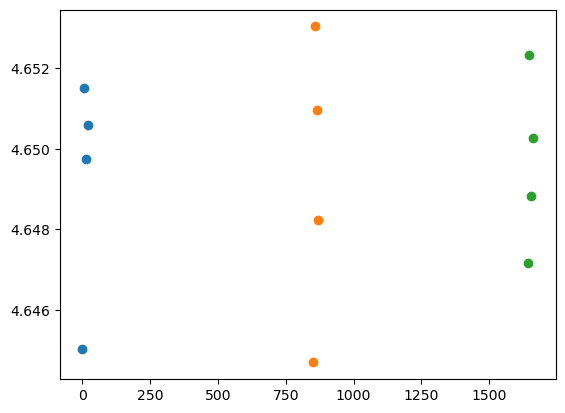

In [9]:
plt.scatter(((att[::980,1]-t0[0].decimalyear)*units.year).to(units.minute),att[::980,2])
plt.scatter(((att[1::980,1]-t0[0].decimalyear)*units.year).to(units.minute),att[1::980,2])
plt.scatter(((att[2::980,1]-t0[0].decimalyear)*units.year).to(units.minute),att[2::980,2])

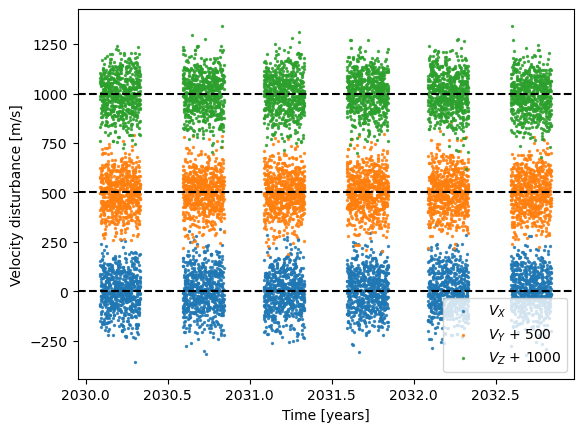

In [10]:
plt.scatter(att[:,1],ephis_true[:,3]-ephis[:,3],label=r"$V_X$",s=2,alpha=0.8)
plt.axhline(0,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,4]-ephis[:,4] + 500,label=r"$V_Y$ + 500",s=2,alpha=0.8)
plt.axhline(500,color="k",ls="--")
plt.scatter(att[:,1],ephis_true[:,5]-ephis[:,5] + 2*500,label=r"$V_Z$ + 1000",s=2,alpha=0.8)
plt.axhline(2*500,color="k",ls="--")
plt.xlabel("Time [years]")
plt.ylabel("Velocity disturbance [m/s]")
plt.legend();

In [11]:
model = jax.jit(lambda s,a,c,t,ephi: jnp.asarray(_fovrs2fprs(*_comrs2fovrs(*_icrs2comrs(s[0],s[1],t,ephi),a[0],a[1],a[2]),a[3])))

In [12]:
sig_obs = 1/_radiants_to_mas
obs = generate_mock_obs_wephemeris(src,att,None,ephis_true,model,FoV_sizes,sig_obs)

In [13]:
df = pd.DataFrame(obs,columns=["sid","expid","axis","value"])

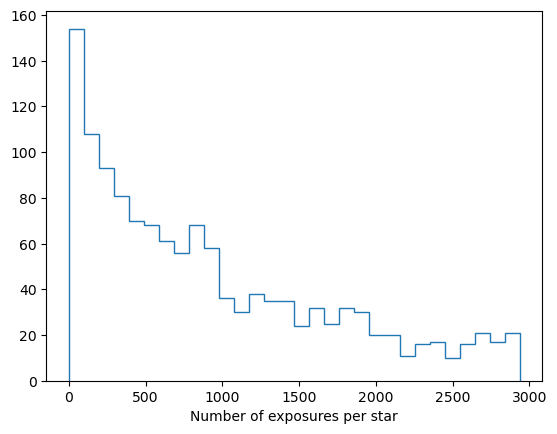

In [14]:
plt.hist(df.groupby(["sid","axis"]).count().query("axis==0")["value"],bins=30,histtype="step");
plt.xlabel("Number of exposures per star");

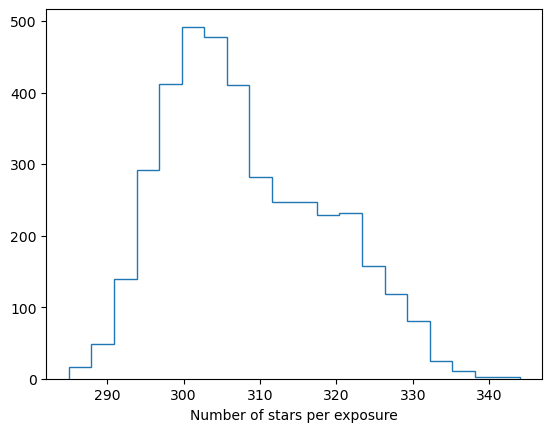

In [15]:
plt.hist(df.groupby(["expid","axis"]).count().query("axis==0")["value"],bins=20,histtype="step");
plt.xlabel("Number of stars per exposure");

In [16]:
observed_sid = np.vstack(df.groupby(["sid","axis"]).count().query("axis==0").query("value>10").index.values)[:,0]

In [17]:
src_obs_mask = np.isin(src[:,0],observed_sid)

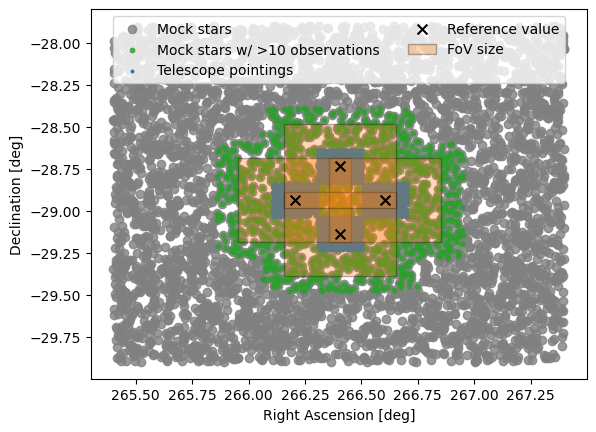

In [18]:
from matplotlib.patches import Rectangle

fig,ax = plt.subplots()

ax.scatter(np.rad2deg(src[:,1]),np.rad2deg(src[:,2]),color="grey",alpha=0.8,label="Mock stars")
ax.scatter(np.rad2deg(src[src_obs_mask,1]),np.rad2deg(src[src_obs_mask,2]),color="tab:green",
           alpha=0.8,s=10,label="Mock stars w/ >10 observations")

ax.scatter(np.rad2deg(att[:,2]),np.rad2deg(att[:,3]),zorder=1,s=3,label="Telescope pointings")
for i,aux in enumerate(fovs):
    if i == 0:
        ax.scatter(aux[0][0],aux[0][1],marker="x",color="k",s=50,zorder=100,label="Reference value")
        left, bottom, width, height = [aux[0][0]-aux[3]/2,aux[0][1]-aux[3]/2,aux[3],aux[3]]
        rect = plt.Rectangle((left, bottom), width, height,
                         facecolor="tab:orange",edgecolor="k", alpha=0.3,label="FoV size")
    else:
        ax.scatter(aux[0][0],aux[0][1],marker="x",color="k",s=50,zorder=100)
        left, bottom, width, height = [aux[0][0]-aux[3]/2,aux[0][1]-aux[3]/2,aux[3],aux[3]]
        rect = plt.Rectangle((left, bottom), width, height,
                         facecolor="tab:orange",edgecolor="k", alpha=0.3)
    ax.add_patch(rect)

ax.legend(ncols=2,loc="upper center")
ax.set_xlabel("Right Ascension [deg]")
ax.set_ylabel("Declination [deg]");

In [23]:
%%time
src_opt,att_opt,cal_opt = bloc_iteration(shat,ahat,None,ephis,obs,model,1,1,1)

CPU times: user 19min 19s, sys: 1min 57s, total: 21min 17s
Wall time: 13min 53s


In [25]:
print(sig_obs*_radiants_to_mas/np.sqrt(len(att)),np.std((src_opt[:,1] - src[:,1])*_radiants_to_mas),np.std((src_opt[:,2] - src[:,2])*_radiants_to_mas))

0.015971914124998494 4.956565638086168 4.986327752940044


#### Plotting residuals

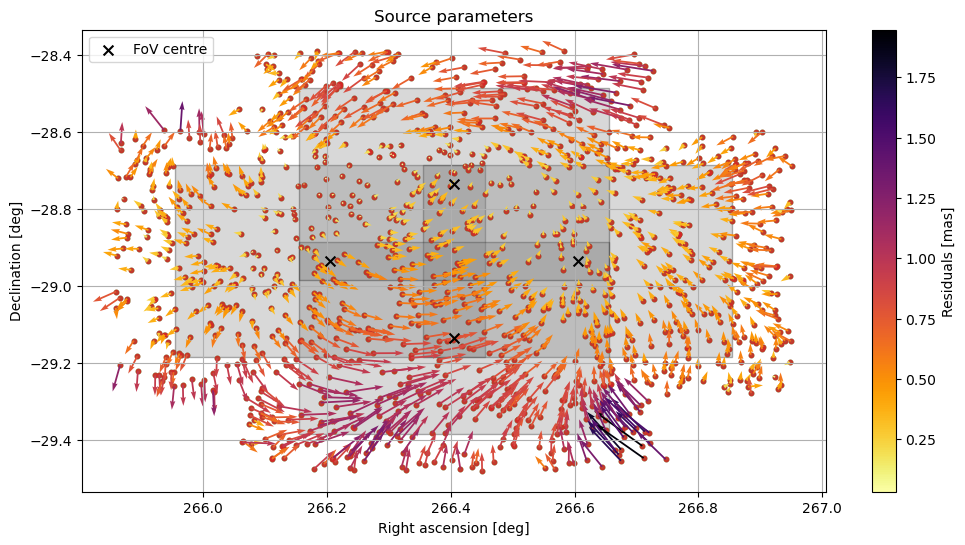

In [65]:
fig,ax = plt.subplots(figsize=(12,6))

for i,aux in enumerate(fovs):
    if i == 0:
        ax.scatter(aux[0][0],aux[0][1],marker="x",color="k",s=50,zorder=100,label="FoV centre")
        left, bottom, width, height = [aux[0][0]-aux[3]/2,aux[0][1]-aux[3]/2,aux[3],aux[3]]
        rect = plt.Rectangle((left, bottom), width, height,
                         facecolor="grey",edgecolor="k", alpha=0.3)
    else:
        ax.scatter(aux[0][0],aux[0][1],marker="x",color="k",s=50,zorder=100)
        left, bottom, width, height = [aux[0][0]-aux[3]/2,aux[0][1]-aux[3]/2,aux[3],aux[3]]
        rect = plt.Rectangle((left, bottom), width, height,
                         facecolor="grey",edgecolor="k", alpha=0.3)
    ax.add_patch(rect)

ax.scatter(np.rad2deg(src[src_obs_mask,1]),np.rad2deg(src[src_obs_mask,2]),s=10,alpha=0.8,color="tab:green");
ax.scatter(np.rad2deg(src_opt[src_obs_mask,1]),np.rad2deg(src_opt[src_obs_mask,2]),s=10,alpha=0.8,color="tab:red");
cc = ax.quiver(np.rad2deg(src[src_obs_mask,1]),np.rad2deg(src[src_obs_mask,2]),
          np.rad2deg(src_opt[src_obs_mask,1]-src[src_obs_mask,1]),np.rad2deg(src_opt[src_obs_mask,2]-src[src_obs_mask,2]),
          np.sqrt((src_opt[src_obs_mask,1]-src[src_obs_mask,1])**2+(src_opt[src_obs_mask,2]-src[src_obs_mask,2])**2)*_radiants_to_mas,
          cmap = "inferno_r",scale_units="xy",scale=0.5e-5);

plt.colorbar(cc,label="Residuals [mas]")

ax.legend(loc="upper left")
ax.set_ylabel("Declination [deg]")
ax.set_xlabel("Right ascension [deg]")
ax.set_title("Source parameters")
ax.grid();

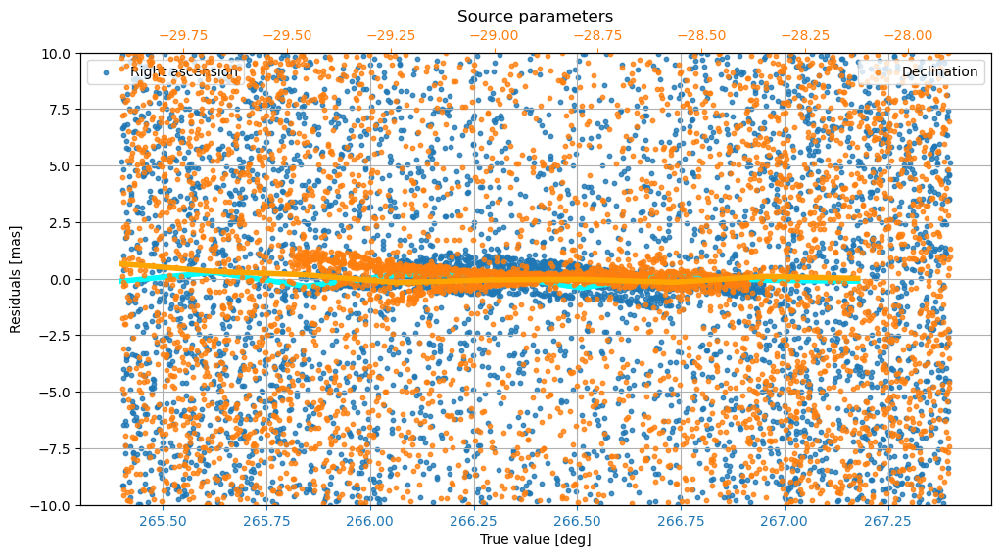

In [29]:
fig,ax = plt.subplots(figsize=(12,6))

ra_bins = np.linspace(np.min(src[:,1]),np.max(src[:,1]),10)
mean_ra_res,_,_ = scipy.stats.binned_statistic(src[:,1],(src_opt[:,1] - src[:,1])*_radiants_to_mas,bins=ra_bins)
ax.scatter(np.rad2deg(src[:,1]),(src_opt[:,1] - src[:,1])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");
ax.plot(np.rad2deg(ra_bins[:-1]),mean_ra_res,color="cyan",lw=4,zorder=100)


ax2 = ax.twiny()

dec_bins = np.linspace(np.min(src[:,2]),np.max(src[:,2]),10)
mean_dec_res,_,_ = scipy.stats.binned_statistic(src[:,2],(src_opt[:,2] - src[:,2])*_radiants_to_mas,bins=dec_bins)
ax2.scatter(np.rad2deg(src[:,2]),(src_opt[:,2] - src[:,2])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");
ax2.plot(np.rad2deg(dec_bins[:-1]),mean_dec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Source parameters")
ax.set_ylim(-10,10);
ax.grid();

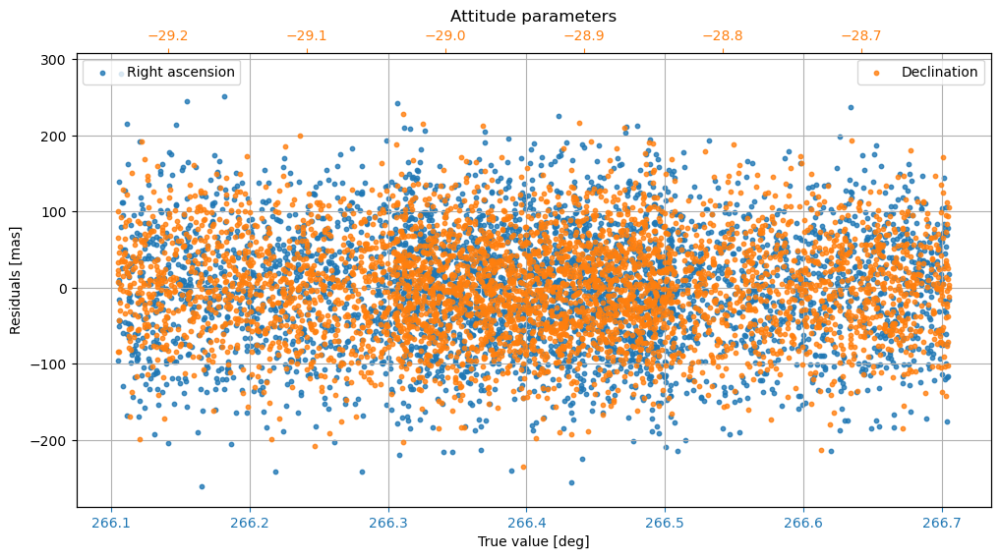

In [30]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,2]),(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.8,color="tab:blue");

ax2 = ax.twiny()
ax2.scatter(np.rad2deg(att[:,3]),(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.8,color="tab:orange");

ax.legend(loc="upper left")
ax2.legend(loc="upper right")
ax.tick_params(axis='x', colors='tab:blue')
ax2.tick_params(axis='x', colors='tab:orange')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

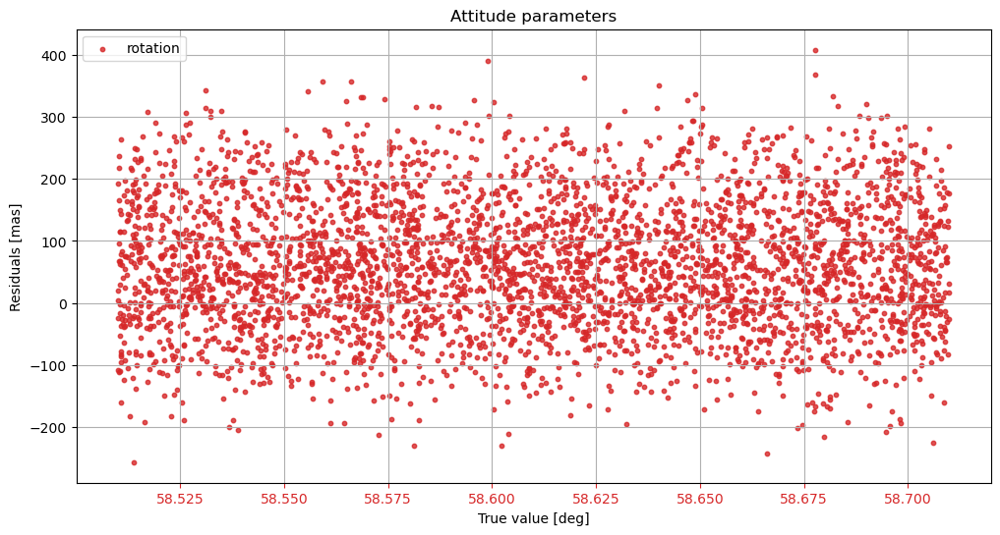

In [31]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(np.rad2deg(att[:,4]),(att_opt[:,4] - att[:,4])*_radiants_to_mas,label="rotation",s=10,alpha=0.8,color="tab:red");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:red')
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("True value [deg]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-80,80);
ax.grid();

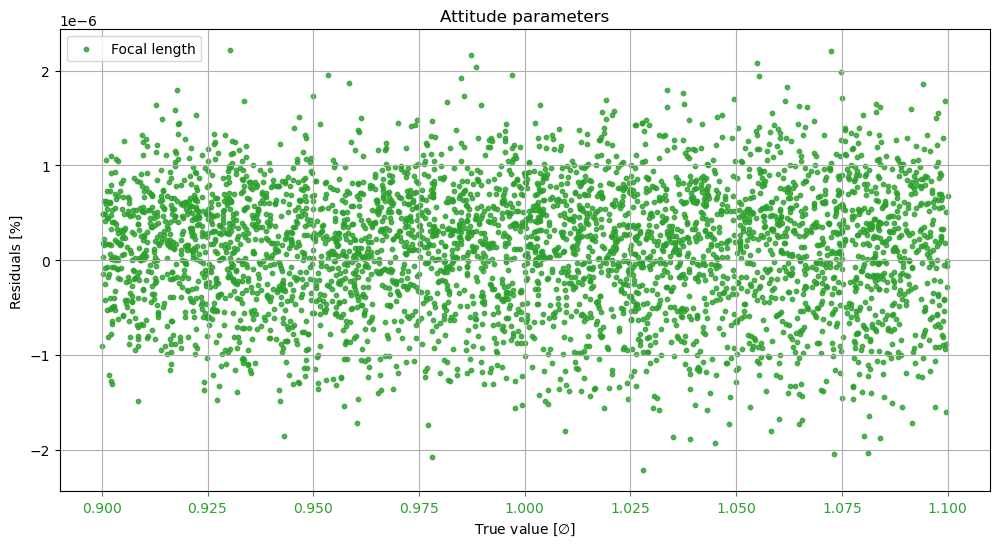

In [32]:
fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,5],(att_opt[:,5] - att[:,5]),label="Focal length",s=10,alpha=0.8,color="tab:green");

ax.legend(loc="upper left")
ax.tick_params(axis='x', colors='tab:green')
ax.set_ylabel("Residuals [%]")
ax.set_xlabel(r"True value [$\emptyset$]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-0.0005,0.0005);
ax.grid();

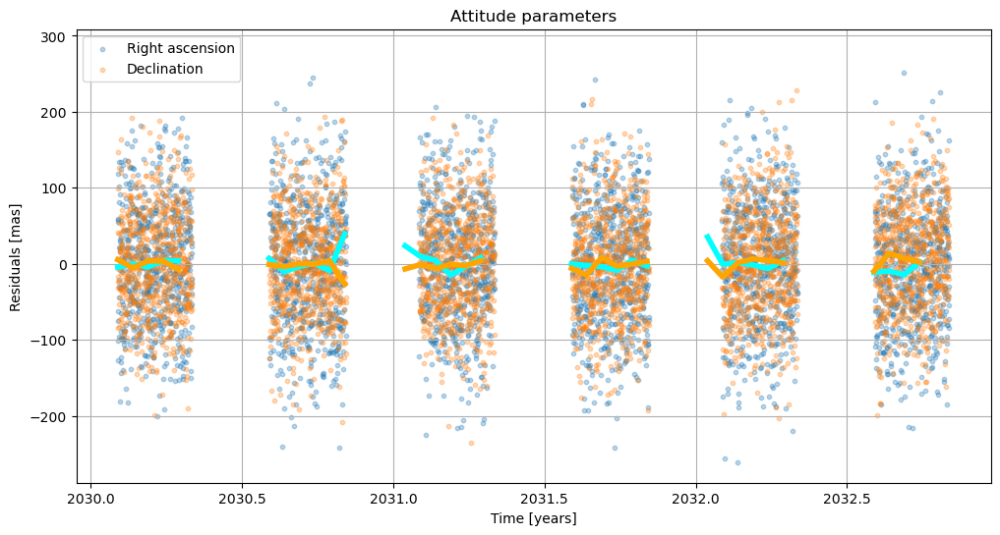

In [34]:
t_bins = np.arange(att[0,1],att[-1,1],0.05)
mean_ptra_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,bins=t_bins)
mean_ptdec_res,_,_ = scipy.stats.binned_statistic(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,bins=t_bins)

fig,ax = plt.subplots(figsize=(12,6))

ax.scatter(att[:,1],(att_opt[:,2] - att[:,2])*_radiants_to_mas,label="Right ascension",s=10,alpha=0.3,color="tab:blue");
ax.scatter(att[:,1],(att_opt[:,3] - att[:,3])*_radiants_to_mas,label="Declination",s=10,alpha=0.3,color="tab:orange");

ax.plot(t_bins[:-1],mean_ptra_res,color="cyan",lw=4)
ax.plot(t_bins[:-1],mean_ptdec_res,color="orange",lw=4)

ax.legend(loc="upper left")
ax.set_ylabel("Residuals [mas]")
ax.set_xlabel("Time [years]")
ax.set_title("Attitude parameters")
#ax.set_ylim(-20,20);
#ax.set_xlim(2030,2030.5)
ax.grid();

In [35]:
original_att_df = pd.DataFrame(att,columns=["eid","time","alfa0","delta0","rot0","F0"]).sort_values(by="eid")

In [36]:
result_att_df = pd.DataFrame(att_opt,columns=["eid","time","alfa0_est","delta0_est","rot0_est","F0_est"]).sort_values(by="eid")

In [37]:
guess_att_df = pd.DataFrame(ahat,columns=["eid","time","alfa0_guess","delta0_guess","rot0_guess","F0_guess"]).sort_values(by="eid")

In [38]:
original_df = pd.DataFrame(src,columns=["sid","alfa0","delta0"]).sort_values(by="sid")

In [39]:
result_df = pd.DataFrame(src_opt,columns=["sid","alfa0_est","delta0_est"]).sort_values(by="sid")

In [40]:
guess_df = pd.DataFrame(shat,columns=["sid","alfa0_guess","delta0_guess"]).sort_values(by="sid")

In [41]:
obs_df = pd.DataFrame(obs,columns=["sid","eid","axis","value"])

In [42]:
num_exp = (obs_df.groupby("sid").count()["value"].values/2).astype(int)

In [43]:
num_sources = (obs_df.groupby("eid").count()["value"].values/2).astype(int)

In [44]:
num_exp_df = obs_df.groupby("sid").count()["value"]

In [45]:
result_df = result_df.join(original_df,rsuffix="_o")[["sid","alfa0","delta0","alfa0_est","delta0_est"]]
result_df = result_df.join(guess_df,rsuffix="_o")[["sid","alfa0","delta0","alfa0_est","delta0_est","alfa0_guess","delta0_guess"]]

In [46]:
for index in num_exp_df.index:
    numexp = num_exp_df.loc[index]
    result_df.loc[index,"num_exp"] = int(numexp/2)

In [47]:
result_df

,sid,alfa0,delta0,alfa0_est,delta0_est,alfa0_guess,delta0_guess,num_exp
0,0.0,4.638272,-0.513687,4.638272,-0.513687,4.638272,-0.513687,NaN
1,1.0,4.633573,-0.511281,4.633573,-0.511282,4.633573,-0.511282,NaN
2,2.0,4.660712,-0.490998,4.660712,-0.490998,4.660712,-0.490998,NaN
3,3.0,4.641737,-0.510061,4.641737,-0.510061,4.641737,-0.510061,160.0
4,4.0,4.656831,-0.508593,4.656831,-0.508593,4.656831,-0.508593,497.0
...,...,...,...,...,...,...,...,...
4995,4995.0,4.645608,-0.490266,4.645608,-0.490266,4.645608,-0.490266,NaN
4996,4996.0,4.662484,-0.518320,4.662484,-0.518320,4.662484,-0.518320,NaN
4997,4997.0,4.663641,-0.502238,4.663641,-0.502238,4.663641,-0.502238,NaN
4998,4998.0,4.659207,-0.515922,4.659207,-0.515922,4.659207,-0.515922,NaN


In [48]:
result_att_df = result_att_df.join(original_att_df,rsuffix="_o")[["eid","alfa0","delta0","rot0","F0",
                                                                  "alfa0_est","delta0_est","rot0_est","F0_est"]]

result_att_df = result_att_df.join(guess_att_df,rsuffix="_o")[["eid","alfa0","delta0","rot0","F0",
                                                                  "alfa0_est","delta0_est","rot0_est","F0_est",
                                                              "alfa0_guess","delta0_guess","rot0_guess","F0_guess"]]

In [49]:
result_att_df["num_src"] = num_sources

In [50]:
result_att_df

,eid,alfa0,delta0,rot0,F0,alfa0_est,delta0_est,rot0_est,F0_est,alfa0_guess,delta0_guess,rot0_guess,F0_guess,num_src
0,0.0,4.645019,-0.505041,1.023428,0.967543,4.645019,-0.505041,1.023427,0.967543,4.645019,-0.505043,1.023427,0.967541,302
1,1.0,4.644693,-0.504476,1.021564,1.042529,4.644694,-0.504477,1.021564,1.042529,4.644693,-0.504472,1.021562,1.042526,295
2,2.0,4.647169,-0.506321,1.022918,1.096368,4.647169,-0.506321,1.022919,1.096367,4.647173,-0.506320,1.022917,1.096367,297
3,3.0,4.646611,-0.506675,1.023918,1.097627,4.646611,-0.506675,1.023919,1.097626,4.646613,-0.506674,1.023915,1.097627,292
4,4.0,4.645414,-0.505687,1.023420,1.023541,4.645414,-0.505687,1.023420,1.023540,4.645418,-0.505689,1.023425,1.023543,304
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3915,3915.0,4.648100,-0.501541,1.023630,0.906766,4.648100,-0.501541,1.023631,0.906765,4.648098,-0.501540,1.023626,0.906769,294
3916,3916.0,4.648073,-0.501669,1.022787,0.920252,4.648073,-0.501669,1.022787,0.920252,4.648071,-0.501674,1.022787,0.920251,292
3917,3917.0,4.648888,-0.502345,1.021252,0.952911,4.648888,-0.502345,1.021253,0.952910,4.648893,-0.502342,1.021249,0.952915,305
3918,3918.0,4.650440,-0.499827,1.022064,0.929708,4.650440,-0.499827,1.022064,0.929709,4.650438,-0.499831,1.022060,0.929706,292


In [51]:
result_df.to_csv("/Users/pauramos/Downloads/results_test3.3_4FoV_3920exposures_with10mas1stGuess_sourceparams.csv",index=False)

In [52]:
result_att_df.to_csv("/Users/pauramos/Downloads/results_test3.3_4FoV_3920exposures_with10mas1stGuess_attitudeparams.csv",index=False)

In [56]:
xbins = np.arange(0,650,40)
mean_error_alfa,_,_ = scipy.stats.binned_statistic(result_df["num_exp"],
                                                   (result_df["alfa0_est"] - result_df["alfa0"])*_radiants_to_mas,
                                                   statistic="mean",
                                                   bins=xbins)

mean_error_delta,_,_ = scipy.stats.binned_statistic(result_df["num_exp"],
                                                   (result_df["delta0_est"] - result_df["delta0"])*_radiants_to_mas,
                                                   statistic="mean",
                                                   bins=xbins)

std_error_alfa,_,_ = scipy.stats.binned_statistic(result_df["num_exp"],
                                                   (result_df["alfa0_est"] - result_df["alfa0"])*_radiants_to_mas,
                                                   statistic="std",
                                                   bins=xbins)

std_error_delta,_,_ = scipy.stats.binned_statistic(result_df["num_exp"],
                                                   (result_df["delta0_est"] - result_df["delta0"])*_radiants_to_mas,
                                                   statistic="std",
                                                   bins=xbins)

/var/folders/vj/7jqz0m1j2zs3t7fxnl0d1gfw0000gn/T/ipykernel_59734/2789853165.py:15: RuntimeWarning: divide by zero encountered in divide
  plt.plot(xbins[:-1],sig_obs*_radiants_to_mas/np.sqrt(xbins[:-1]),color="k",ls="-.",label=r"$\sigma_{obs}/\sqrt{nobs}$")
/var/folders/vj/7jqz0m1j2zs3t7fxnl0d1gfw0000gn/T/ipykernel_59734/2789853165.py:16: RuntimeWarning: divide by zero encountered in divide
  plt.plot(xbins[:-1],-sig_obs*_radiants_to_mas/np.sqrt(xbins[:-1]),color="k",ls="-.")


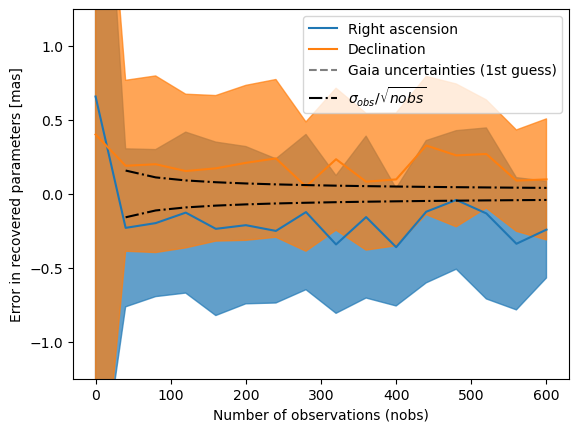

In [58]:
#plt.scatter(result_df["num_exp"],(result_df["alfa0_est"] - result_df["alfa0"])*_radiants_to_mas,s=1,alpha=0.5)
#plt.scatter(result_df["num_exp"],(result_df["delta0_est"] - result_df["delta0"])*_radiants_to_mas,s=1,alpha=0.5)

plt.plot(xbins[:-1],mean_error_alfa,label="Right ascension")
plt.plot(xbins[:-1],mean_error_delta,label="Declination")

plt.fill_between(xbins[:-1],mean_error_alfa-1*std_error_alfa,mean_error_alfa+1*std_error_alfa,alpha=0.7,color="tab:blue")
plt.fill_between(xbins[:-1],mean_error_delta-1*std_error_delta,mean_error_delta+1*std_error_delta,alpha=0.7,color="tab:orange")

plt.axhline(src_guess_error*_radiants_to_mas,ls="--",color="grey",label="Gaia uncertainties (1st guess)")
plt.axhline(-src_guess_error*_radiants_to_mas,ls="--",color="grey")
#plt.axhline(sig_obs*_radiants_to_mas,ls=":",color="grey",label=r"Observational uncertainties ($\sigma_{obs}$)")
#plt.axhline(-sig_obs*_radiants_to_mas,ls=":",color="grey")

plt.plot(xbins[:-1],sig_obs*_radiants_to_mas/np.sqrt(xbins[:-1]),color="k",ls="-.",label=r"$\sigma_{obs}/\sqrt{nobs}$")
plt.plot(xbins[:-1],-sig_obs*_radiants_to_mas/np.sqrt(xbins[:-1]),color="k",ls="-.")
         
plt.legend()
plt.ylim(-1.25,1.25)
plt.xlabel("Number of observations (nobs)")
plt.ylabel("Error in recovered parameters [mas]");